In [1]:
"""
Colourization of CIFAR-10 Horses via classification.
"""
import argparse
import math
import time

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import numpy.random as npr
import scipy.misc
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchsummary import summary

In [2]:
%mkdir -p /content/a3/
%cd /content/a3


/content/a3


In [3]:
import os
import pickle
import sys
import tarfile

import numpy as np
from PIL import Image
from six.moves.urllib.request import urlretrieve


def get_file(fname, origin, untar=False, extract=False, archive_format="auto", cache_dir="data"):
    datadir = os.path.join(cache_dir)
    if not os.path.exists(datadir):
        os.makedirs(datadir)

    if untar:
        untar_fpath = os.path.join(datadir, fname)
        fpath = untar_fpath + ".tar.gz"
    else:
        fpath = os.path.join(datadir, fname)

    print("File path: %s" % fpath)
    if not os.path.exists(fpath):
        print("Downloading data from", origin)

        error_msg = "URL fetch failure on {}: {} -- {}"
        try:
            try:
                urlretrieve(origin, fpath)
            except URLError as e:
                raise Exception(error_msg.format(origin, e.errno, e.reason))
            except HTTPError as e:
                raise Exception(error_msg.format(origin, e.code, e.msg))
        except (Exception, KeyboardInterrupt) as e:
            if os.path.exists(fpath):
                os.remove(fpath)
            raise

    if untar:
        if not os.path.exists(untar_fpath):
            print("Extracting file.")
            with tarfile.open(fpath) as archive:
                archive.extractall(datadir)
        return untar_fpath

    if extract:
        _extract_archive(fpath, datadir, archive_format)

    return fpath


def load_batch(fpath, label_key="labels"):
    """Internal utility for parsing CIFAR data.
    # Arguments
        fpath: path the file to parse.
        label_key: key for label data in the retrieve
            dictionary.
    # Returns
        A tuple `(data, labels)`.
    """
    f = open(fpath, "rb")
    if sys.version_info < (3,):
        d = pickle.load(f)
    else:
        d = pickle.load(f, encoding="bytes")
        # decode utf8
        d_decoded = {}
        for k, v in d.items():
            d_decoded[k.decode("utf8")] = v
        d = d_decoded
    f.close()
    data = d["data"]
    labels = d[label_key]

    data = data.reshape(data.shape[0], 3, 32, 32)
    return data, labels


def load_cifar10(transpose=False):
    """Loads CIFAR10 dataset.
    # Returns
        Tuple of Numpy arrays: `(x_train, y_train), (x_test, y_test)`.
    """
    dirname = "cifar-10-batches-py"
    origin = "http://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
    path = get_file(dirname, origin=origin, untar=True)

    num_train_samples = 50000

    x_train = np.zeros((num_train_samples, 3, 32, 32), dtype="uint8")
    y_train = np.zeros((num_train_samples,), dtype="uint8")

    for i in range(1, 6):
        fpath = os.path.join(path, "data_batch_" + str(i))
        data, labels = load_batch(fpath)
        x_train[(i - 1) * 10000 : i * 10000, :, :, :] = data
        y_train[(i - 1) * 10000 : i * 10000] = labels

    fpath = os.path.join(path, "test_batch")
    x_test, y_test = load_batch(fpath)

    y_train = np.reshape(y_train, (len(y_train), 1))
    y_test = np.reshape(y_test, (len(y_test), 1))

    if transpose:
        x_train = x_train.transpose(0, 2, 3, 1)
        x_test = x_test.transpose(0, 2, 3, 1)
    return (x_train, y_train), (x_test, y_test)

In [4]:
# Download CIFAR dataset
m = load_cifar10()

File path: data/cifar-10-batches-py.tar.gz


## Data Preparation


In [5]:
(x_train, y_train), (x_test, y_test) = m
print('images in train:',x_train.shape[0],'\nimages in test:',x_test.shape[0])
print('image size:',x_train[0].shape)
print('train data organization',x_train.shape)
print('test data organization',x_test.shape)

images in train: 50000 
images in test: 10000
image size: (3, 32, 32)
train data organization (50000, 3, 32, 32)
test data organization (10000, 3, 32, 32)


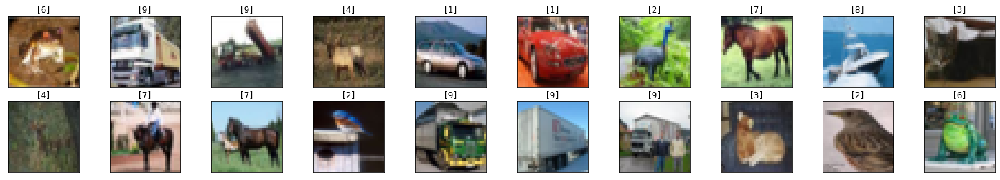

In [6]:
# code to examine the dataset

images = x_train

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title([y_train[idx][0]])
plt.show()

In [7]:
# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):
    """
    Pre-process CIFAR10 images by taking only the horse category,
    shuffling, and have colour values be bound between 0 and 1

    Args:
      xs: the colour RGB pixel values
      ys: the category labels
      max_pixel: maximum pixel value in the original data
    Returns:
      xs: value normalized and shuffled colour images
      grey: greyscale images, also normalized so values are between 0 and 1
    """
    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    if downsize_input:
        downsize_module = nn.Sequential(
            nn.AvgPool2d(2),
            nn.AvgPool2d(2),
            nn.Upsample(scale_factor=2),
            nn.Upsample(scale_factor=2),
        )
        xs_downsized = downsize_module.forward(torch.from_numpy(xs).float())
        xs_downsized = xs_downsized.data.numpy()
        return (xs, xs_downsized)
    else:
        return (xs, grey)


In [8]:
xtrain,processed_xtrain = process(x_train,y_train)

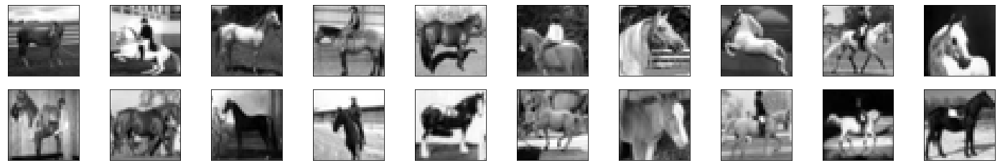

In [9]:
images = xtrain

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    plt.imshow(processed_xtrain[idx][0,:,:],cmap='gray')
plt.show()

In [10]:
# dataloader for batching samples

def get_batch(x, y, batch_size):
    """
    Generated that yields batches of data

    Args:
      x: input values
      y: output values
      batch_size: size of each batch
    Yields:
      batch_x: a batch of inputs of size at most batch_size
      batch_y: a batch of outputs of size at most batch_size
    """
    N = np.shape(x)[0]
    assert N == np.shape(y)[0]
    for i in range(0, N, batch_size):
        batch_x = x[i : i + batch_size, :, :, :]
        batch_y = y[i : i + batch_size, :, :, :]
        yield (batch_x, batch_y)

In [11]:
# code to load different batches of horse dataset

print("Loading data...")
(x_train, y_train), (x_test, y_test) = load_cifar10()

print("Transforming data...")
train_rgb, train_grey = process(x_train, y_train)
test_rgb, test_grey = process(x_test, y_test)


Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...


In [12]:
# shape of data and labels before selection
print(x_train.shape, y_train.shape)

(50000, 3, 32, 32) (50000, 1)


In [13]:
# shape of training data
print('Training Data: ', train_rgb.shape, train_grey.shape)
# shape of testing data
print('Testing Data: ', test_rgb.shape, test_grey.shape)

Training Data:  (5000, 3, 32, 32) (5000, 1, 32, 32)
Testing Data:  (1000, 3, 32, 32) (1000, 1, 32, 32)


## Colourization as Regression


Regression Architecture

In [16]:
class RegressionCNN(nn.Module):
    def __init__(self, kernel, num_filters):
        # first call parent's initialization function
        super().__init__()
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU(),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.ReLU())

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters, 3, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 3, kernel_size=kernel, padding=padding)

    def forward(self, x):
        out = self.downconv1(x)
        out = self.downconv2(out)
        out = self.rfconv(out)
        out = self.upconv1(out)
        out = self.upconv2(out)
        out = self.finalconv(out)
        return out

Training code

In [17]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): rgb as labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
        train_losses.append(np.mean(losses))
        print(epoch, loss.cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)
        plt.figure()
        
    plt.plot(train_losses, label="Train")
    plt.legend()
    plt.title("Loss")
    plt.xlabel("Epochs")
    return gen

Training visualization code

In [70]:
# visualize 5 train/test images
def visual(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach()
    img_real = img_real.cpu().detach()
    img_fake = img_fake.cpu().detach()

  if flag_torch:
    img_grey = img_grey.numpy()
    img_real = img_real.numpy()
    img_fake = img_fake.numpy()

  if flag_torch == 2:
    img_real = np.transpose(img_real[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()
    img_fake = np.transpose(img_fake[:, :, :, :, :], [0, 4, 2, 3, 1]).squeeze()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 2, 3, 1]).squeeze()
  img_real = np.transpose(img_real[:5, :, :, :], [0, 2, 3, 1])
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 2, 3, 1])

  for i in range(5):
      ax = plt.subplot(3, 5, i + 1)
      ax.imshow(img_grey[i], cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 5)
      ax.imshow(img_real[i])
      ax.axis("off")
      ax = plt.subplot(3, 5, i + 1 + 10)
      ax.imshow(np.clip(img_fake[i],0,1))
      ax.axis("off")
  plt.show()

## Skip Connections

In [25]:
class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        self.downconv1 = nn.Sequential(
          nn.Conv2d(num_in_channels, num_filters, kernel_size = kernel, padding = padding),
          nn.MaxPool2d(2),
          nn.BatchNorm2d(num_filters),
          nn.ReLU())
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters * 2, kernel_size = kernel,padding = padding),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters * 2, num_filters * 2, kernel_size = kernel,
                      padding = padding),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.upconv1 = nn.Sequential(
            nn.Conv2d(4 * num_filters, num_filters, kernel_size = kernel,
                      padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(num_filters),
            nn.ReLU())
        self.upconv2 = nn.Sequential(
            nn.Conv2d(2 * num_filters, 3, kernel_size = kernel, padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(3),
            nn.ReLU())
        self.finalconv = nn.Conv2d(4, 3, kernel_size = kernel, padding = padding)

    def forward(self, x):

        out1 = self.downconv1(x)
        out2 = self.downconv2(out1)
        out3 = self.rfconv(out2)
        out4 = self.upconv1(torch.cat((out2, out3), 1))
        out5 = self.upconv2(torch.cat((out1, out4), 1))
        out = self.finalconv(torch.cat((out5, x), 1))
        return out

In [26]:
m = UNet(3,32)
m.cuda()
summary(m, (1, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 32, 32]             320
         MaxPool2d-2           [-1, 32, 16, 16]               0
       BatchNorm2d-3           [-1, 32, 16, 16]              64
              ReLU-4           [-1, 32, 16, 16]               0
            Conv2d-5           [-1, 64, 16, 16]          18,496
         MaxPool2d-6             [-1, 64, 8, 8]               0
       BatchNorm2d-7             [-1, 64, 8, 8]             128
              ReLU-8             [-1, 64, 8, 8]               0
            Conv2d-9             [-1, 64, 8, 8]          36,928
      BatchNorm2d-10             [-1, 64, 8, 8]             128
             ReLU-11             [-1, 64, 8, 8]               0
           Conv2d-12             [-1, 32, 8, 8]          36,896
         Upsample-13           [-1, 32, 16, 16]               0
      BatchNorm2d-14           [-1, 32,

In [27]:
def train(args, gen=None):

    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE MODEL
    if gen is None:
        Net = globals()[args.model]
        gen = Net(args.kernel, args.num_filters)

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(gen.parameters(), lr=args.learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        gen.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    vlosses = []
    total = 0
    correct = 0
    for epoch in range(args.epochs):
        # Train the Model
        gen.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = gen(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
        train_losses.append(np.mean(losses))
        print(epoch, 'Training loss',loss.cpu().detach())

        gen.eval()
        for i, (xs, ys) in enumerate(get_batch(test_grey, test_rgb, args.batch_size)):
            vimages, vlabels = get_torch_vars(xs, ys, args.gpu)
            vout = gen(vimages)
            
            vloss = criterion(vout, vlabels)
            vlosses.append(vloss.data.item())

            total += vlabels.size(0) * 32 * 32
            correct += (vout == vlabels.data).sum()
        valid_losses.append(np.mean(vlosses))
        print(epoch, 'validation loss',vloss.cpu().detach(),'validation acc',(100 * correct / total).cpu().detach())
        if args.plot:
          visual(images, labels, outputs, args.gpu, 1)
    plt.figure()
    plt.plot(train_losses, label="Train")
    plt.plot(valid_losses, label="Validation")
    plt.legend()
    plt.title("Loss")
    plt.xlabel("Epochs")
    
    return gen

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Training loss tensor(0.0216)
0 validation loss tensor(0.0240) validation acc tensor(0.)


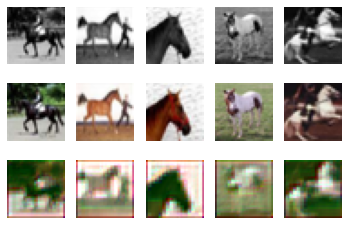

1 Training loss tensor(0.0139)
1 validation loss tensor(0.0141) validation acc tensor(0.)


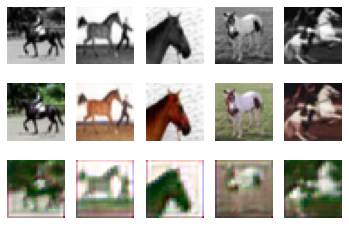

2 Training loss tensor(0.0119)
2 validation loss tensor(0.0120) validation acc tensor(6.5104e-05)


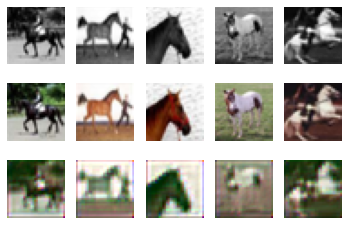

3 Training loss tensor(0.0109)
3 validation loss tensor(0.0109) validation acc tensor(9.7656e-05)


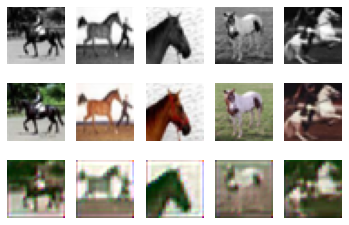

4 Training loss tensor(0.0101)
4 validation loss tensor(0.0101) validation acc tensor(0.0001)


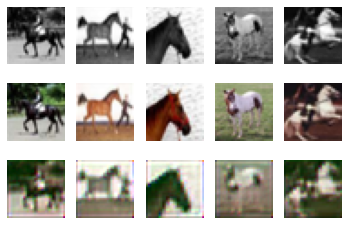

5 Training loss tensor(0.0096)
5 validation loss tensor(0.0096) validation acc tensor(0.0001)


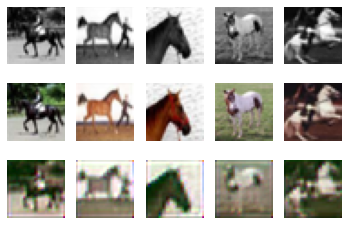

6 Training loss tensor(0.0091)
6 validation loss tensor(0.0091) validation acc tensor(0.0001)


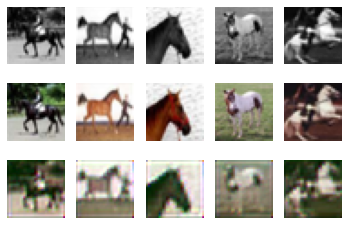

7 Training loss tensor(0.0087)
7 validation loss tensor(0.0087) validation acc tensor(0.0001)


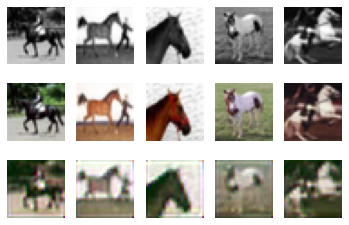

8 Training loss tensor(0.0083)
8 validation loss tensor(0.0084) validation acc tensor(9.7656e-05)


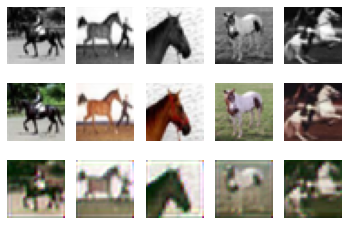

9 Training loss tensor(0.0080)
9 validation loss tensor(0.0081) validation acc tensor(8.7891e-05)


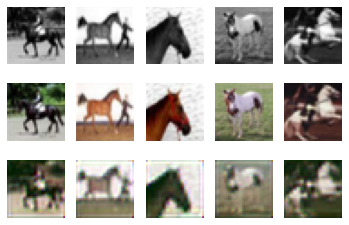

10 Training loss tensor(0.0078)
10 validation loss tensor(0.0078) validation acc tensor(7.9901e-05)


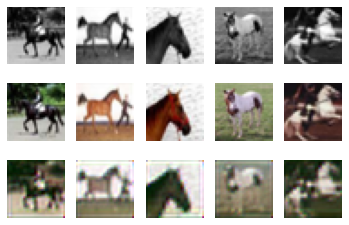

11 Training loss tensor(0.0075)
11 validation loss tensor(0.0075) validation acc tensor(7.3242e-05)


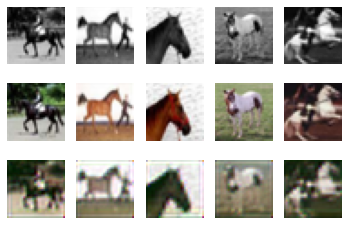

12 Training loss tensor(0.0073)
12 validation loss tensor(0.0073) validation acc tensor(7.5120e-05)


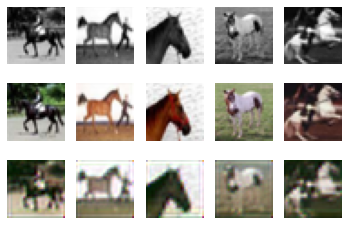

13 Training loss tensor(0.0071)
13 validation loss tensor(0.0071) validation acc tensor(6.9754e-05)


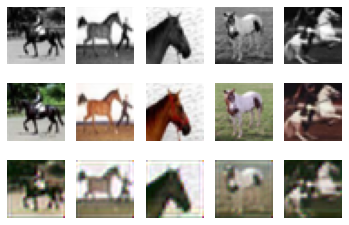

14 Training loss tensor(0.0069)
14 validation loss tensor(0.0069) validation acc tensor(7.1615e-05)


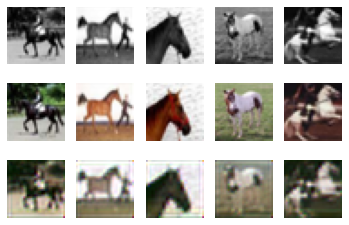

15 Training loss tensor(0.0067)
15 validation loss tensor(0.0067) validation acc tensor(6.7139e-05)


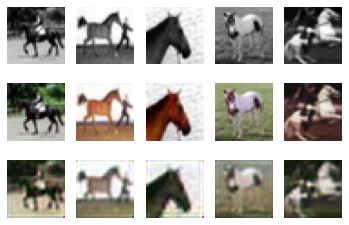

16 Training loss tensor(0.0066)
16 validation loss tensor(0.0066) validation acc tensor(6.8934e-05)


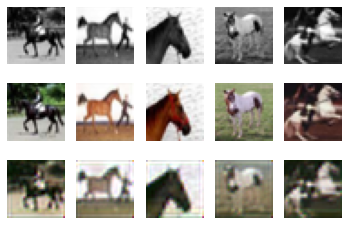

17 Training loss tensor(0.0064)
17 validation loss tensor(0.0065) validation acc tensor(6.5104e-05)


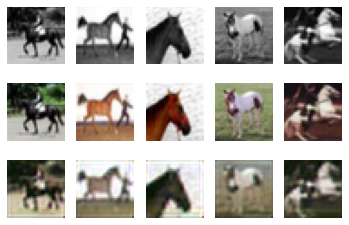

18 Training loss tensor(0.0063)
18 validation loss tensor(0.0063) validation acc tensor(6.1678e-05)


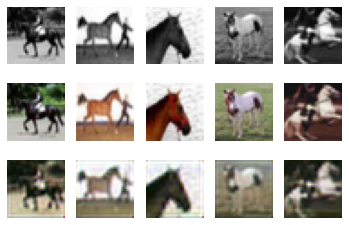

19 Training loss tensor(0.0062)
19 validation loss tensor(0.0062) validation acc tensor(6.3477e-05)


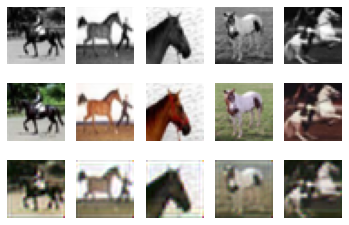

20 Training loss tensor(0.0060)
20 validation loss tensor(0.0061) validation acc tensor(6.5104e-05)


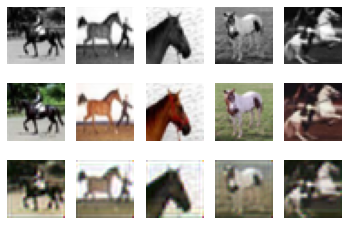

21 Training loss tensor(0.0059)
21 validation loss tensor(0.0060) validation acc tensor(6.2145e-05)


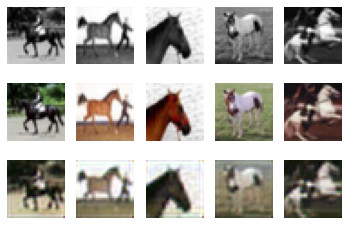

22 Training loss tensor(0.0058)
22 validation loss tensor(0.0059) validation acc tensor(6.3689e-05)


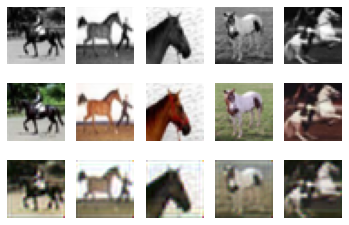

23 Training loss tensor(0.0057)
23 validation loss tensor(0.0058) validation acc tensor(6.9173e-05)


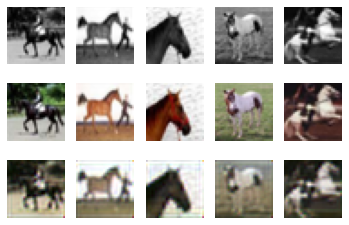

24 Training loss tensor(0.0056)
24 validation loss tensor(0.0058) validation acc tensor(7.0312e-05)


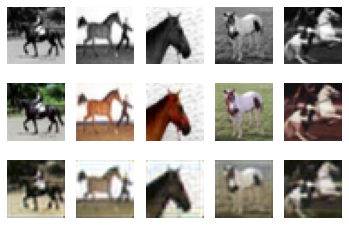

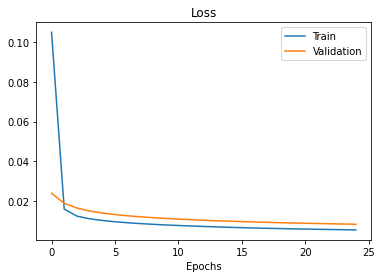

In [28]:
# Main training loop for UNet
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 100,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 Training loss tensor(0.0063)
0 validation loss tensor(0.0066) validation acc tensor(0.)


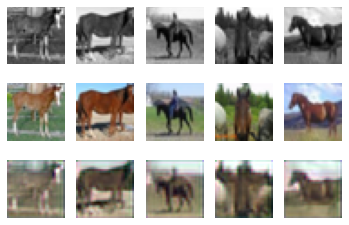

1 Training loss tensor(0.0048)
1 validation loss tensor(0.0052) validation acc tensor(0.)


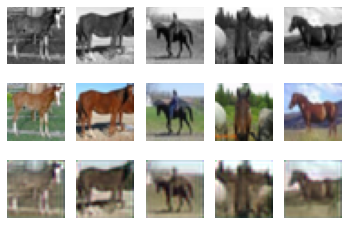

2 Training loss tensor(0.0041)
2 validation loss tensor(0.0046) validation acc tensor(3.2552e-05)


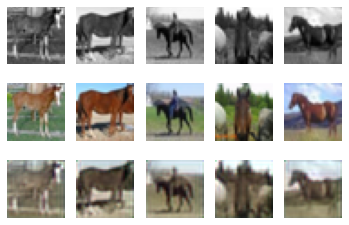

3 Training loss tensor(0.0037)
3 validation loss tensor(0.0043) validation acc tensor(2.4414e-05)


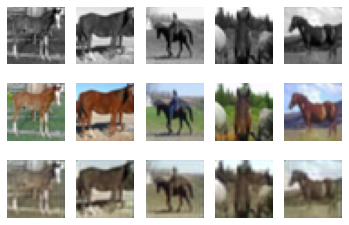

4 Training loss tensor(0.0034)
4 validation loss tensor(0.0041) validation acc tensor(5.8594e-05)


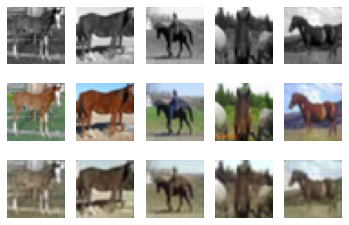

5 Training loss tensor(0.0032)
5 validation loss tensor(0.0040) validation acc tensor(8.1380e-05)


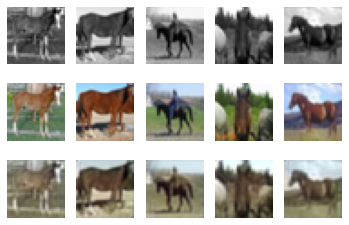

6 Training loss tensor(0.0031)
6 validation loss tensor(0.0038) validation acc tensor(6.9754e-05)


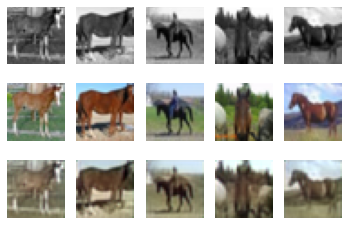

7 Training loss tensor(0.0029)
7 validation loss tensor(0.0037) validation acc tensor(6.1035e-05)


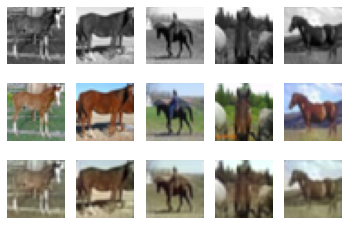

8 Training loss tensor(0.0028)
8 validation loss tensor(0.0037) validation acc tensor(7.5955e-05)


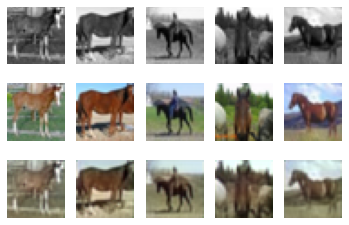

9 Training loss tensor(0.0027)
9 validation loss tensor(0.0036) validation acc tensor(9.7656e-05)


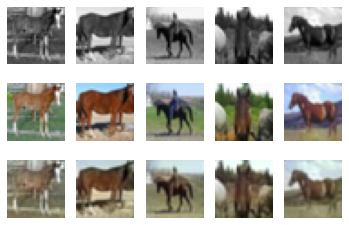

10 Training loss tensor(0.0026)
10 validation loss tensor(0.0036) validation acc tensor(9.7656e-05)


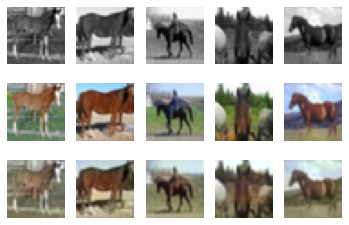

11 Training loss tensor(0.0025)
11 validation loss tensor(0.0036) validation acc tensor(9.7656e-05)


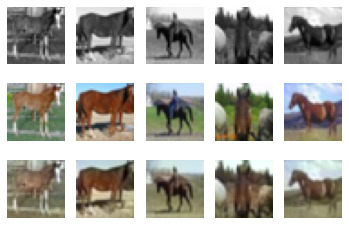

12 Training loss tensor(0.0025)
12 validation loss tensor(0.0036) validation acc tensor(0.0001)


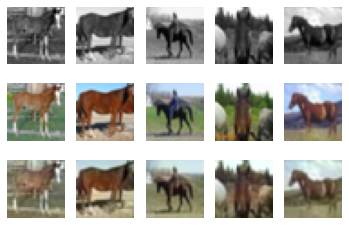

13 Training loss tensor(0.0024)
13 validation loss tensor(0.0036) validation acc tensor(0.0001)


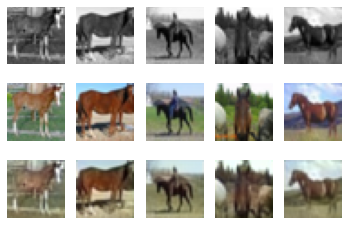

14 Training loss tensor(0.0024)
14 validation loss tensor(0.0037) validation acc tensor(0.0001)


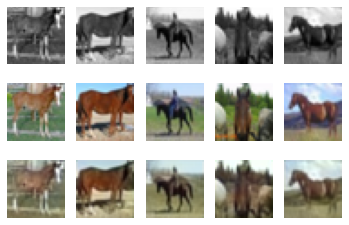

15 Training loss tensor(0.0023)
15 validation loss tensor(0.0037) validation acc tensor(0.0001)


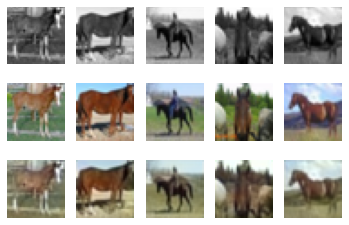

16 Training loss tensor(0.0023)
16 validation loss tensor(0.0037) validation acc tensor(0.0001)


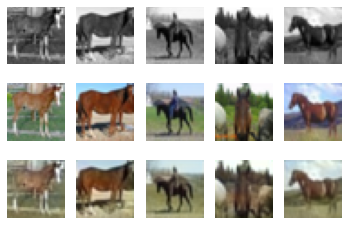

17 Training loss tensor(0.0023)
17 validation loss tensor(0.0037) validation acc tensor(0.0001)


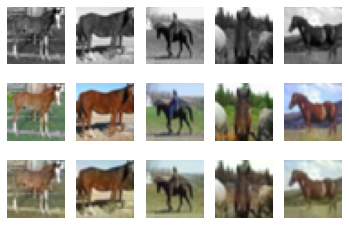

18 Training loss tensor(0.0023)
18 validation loss tensor(0.0037) validation acc tensor(0.0001)


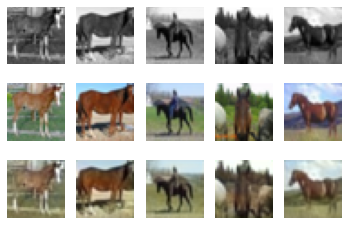

19 Training loss tensor(0.0023)
19 validation loss tensor(0.0037) validation acc tensor(0.0001)


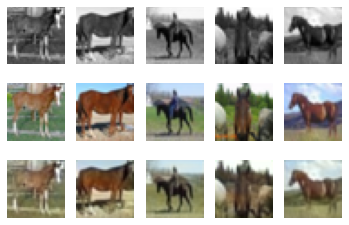

20 Training loss tensor(0.0023)
20 validation loss tensor(0.0038) validation acc tensor(0.0001)


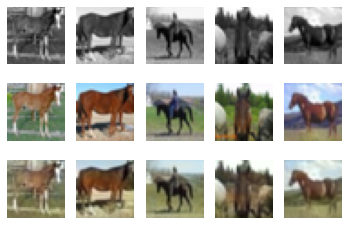

21 Training loss tensor(0.0022)
21 validation loss tensor(0.0039) validation acc tensor(0.0001)


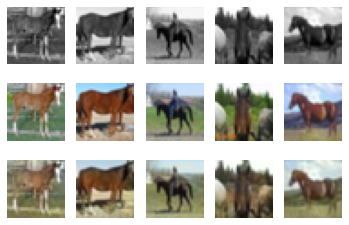

22 Training loss tensor(0.0022)
22 validation loss tensor(0.0038) validation acc tensor(0.0001)


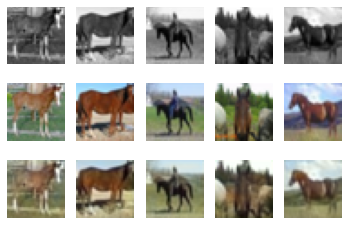

23 Training loss tensor(0.0021)
23 validation loss tensor(0.0039) validation acc tensor(0.0001)


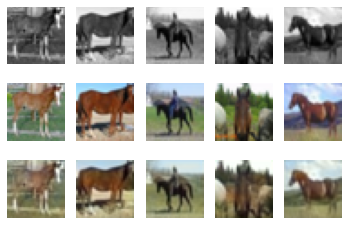

24 Training loss tensor(0.0021)
24 validation loss tensor(0.0040) validation acc tensor(0.0001)


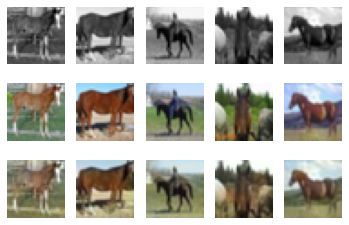

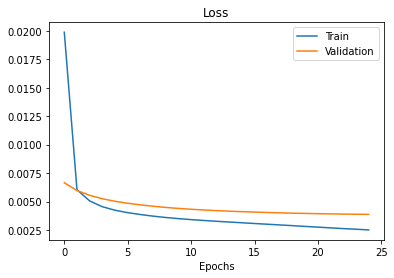

In [31]:
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "UNet",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001, 
    "batch_size": 10,
    "epochs": 25,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

# Conditional GAN 

In [32]:
# I am using unet architechure in the previous cells to create my generator.
class Generator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        self.downconv1 = nn.Sequential(
          nn.Conv2d(num_in_channels, num_filters, kernel_size = kernel, padding = padding),
          nn.MaxPool2d(2),
          nn.BatchNorm2d(num_filters),
          nn.ReLU())
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters * 2, kernel_size = kernel,padding = padding),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters * 2, num_filters * 2, kernel_size = kernel,
                      padding = padding),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.upconv1 = nn.Sequential(
            nn.Conv2d(4 * num_filters, num_filters, kernel_size = kernel,
                      padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(num_filters),
            nn.ReLU())
        self.upconv2 = nn.Sequential(
            nn.Conv2d(2 * num_filters, 4, kernel_size = kernel, padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(4),
            nn.ReLU())
        self.finalconv = nn.Conv2d(5, 3, kernel_size = kernel, padding = padding)



    def forward(self, x):
        out1 = self.downconv1(x)
        out2 = self.downconv2(out1)
        out3 = self.rfconv(out2)
        out4 = self.upconv1(torch.cat((out2, out3), 1))
        out5 = self.upconv2(torch.cat((out1, out4), 1))
        out = self.finalconv(torch.cat((out5, x), 1))

        return out

In [33]:
#testing the generator architecture

m = Generator(3,32)
m.cuda()
m(torch.randn(1,1,32,32).cuda()).shape

torch.Size([1, 3, 32, 32])

In [34]:
# discriminator code

class Discriminator(nn.Module):
    def __init__(self, kernel, num_filters = 8, num_colours=3, num_in_channels=4):
        super().__init__()
        
        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        
        self.disc = nn.Sequential(
            nn.Conv2d(num_in_channels, num_filters , 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters, num_filters*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters*2, num_filters*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters*4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters*4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    
    def forward(self, x, img_greyscale):
        
        img = torch.cat((x,img_greyscale),1)
        out = self.disc(img)
        return out

In [35]:
# testing the discriminator architecture
m = Discriminator(3)
m.cuda()
m(torch.randn(1,3,32,32).cuda(),torch.randn(1,1,32,32).cuda()).squeeze()

tensor(0.5730, device='cuda:0', grad_fn=<SqueezeBackward0>)

### Part (c) [3 pt]
Modify the provided training code to implement a conditional GAN.

In [36]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): categorical labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def train(args, cnn=None):

    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    save_dir = "outputs/" + args.experiment_name


    num_in_channels = 1 if not args.downsize_input else 3

    if cnn is None:
        Net = globals()[args.model]
        cnn = Net(args.kernel, args.num_filters)
        discriminator = Discriminator(args.kernel, args.num_filters)


    # LOSS FUNCTION

    criterion = nn.BCELoss().cuda(args.gpu)                                                     
    g_optimizer = torch.optim.Adam(cnn.parameters(), lr=args.g_learn_rate)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=args.d_learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
        cnn.cuda()
        discriminator.cuda()
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)

            img_grey = images
            img_real = labels
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()
            real_validity = discriminator(img_real,img_grey)
            real_loss = criterion((real_validity).squeeze(), 
                                  Variable(torch.zeros(len(real_validity))).cuda())

            fake_images = cnn(img_grey)

            fake_validity = discriminator(fake_images,img_grey)
            fake_loss = criterion((fake_validity).squeeze(),
                                  Variable(torch.ones(len(fake_validity))).cuda())
            
            d_loss = (real_loss + fake_loss)
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            fake_images = cnn(img_grey)
            f_input = torch.cat((fake_images,img_grey),1)
            validity = discriminator(fake_images,img_grey)
            g_loss = criterion((validity).squeeze(), Variable(torch.zeros(len(validity))).cuda())
            
            g_loss.backward()
            g_optimizer.step()


        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        visual(img_grey, img_real, fake_images, args.gpu, 1)
    


    return cnn

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(8.6506) tensor(0.0184)


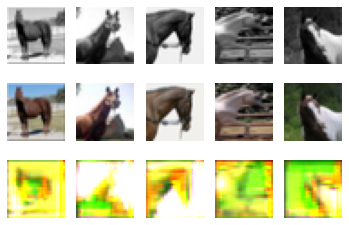

1 tensor(7.7404) tensor(0.0204)


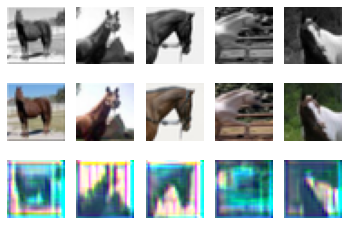

2 tensor(2.1793) tensor(0.7527)


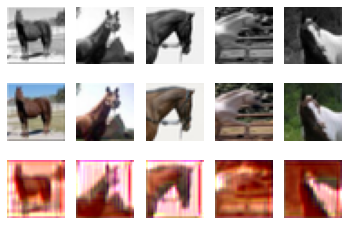

3 tensor(10.3642) tensor(0.0131)


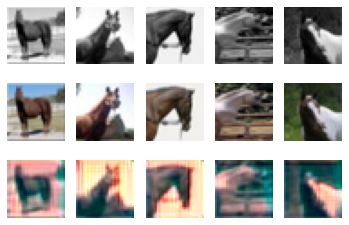

4 tensor(5.3470) tensor(0.0413)


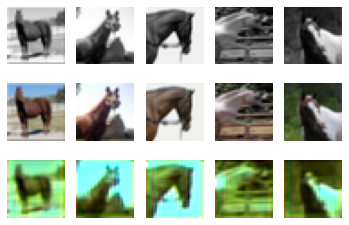

5 tensor(9.3480) tensor(0.0438)


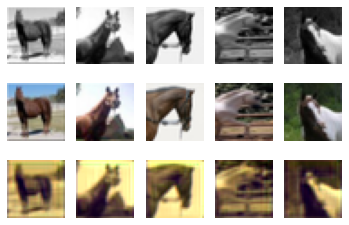

6 tensor(4.8381) tensor(0.1190)


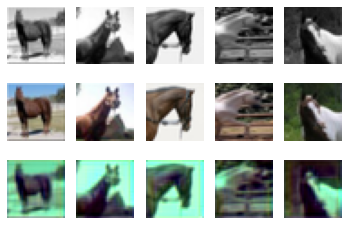

7 tensor(4.9247) tensor(0.0528)


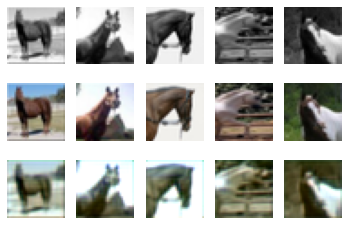

8 tensor(6.9489) tensor(0.0630)


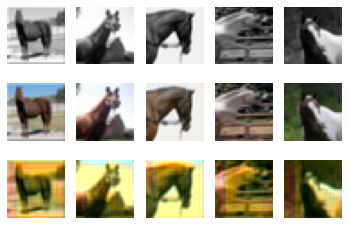

9 tensor(3.9615) tensor(0.5154)


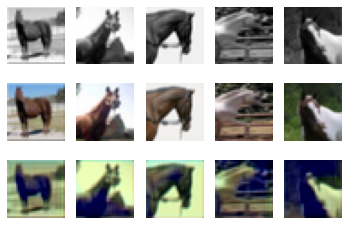

10 tensor(5.5583) tensor(0.3917)


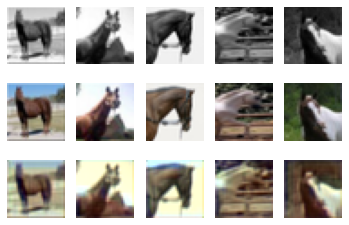

11 tensor(3.6455) tensor(0.3268)


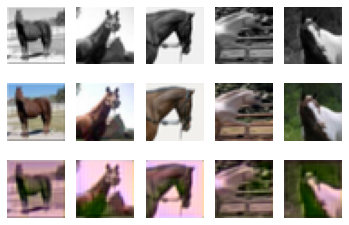

12 tensor(2.4884) tensor(0.9954)


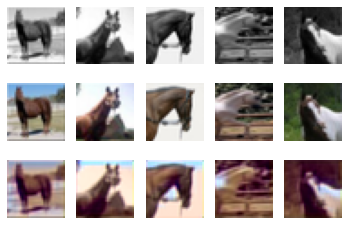

13 tensor(4.6761) tensor(0.2414)


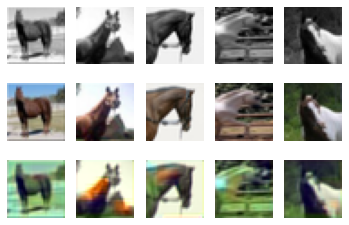

14 tensor(4.2544) tensor(0.1799)


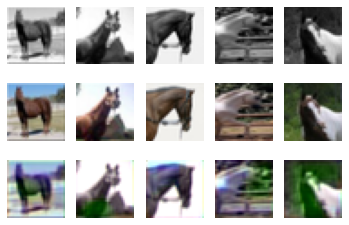

15 tensor(4.2350) tensor(0.4203)


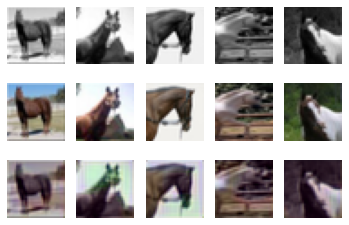

16 tensor(6.4731) tensor(0.0183)


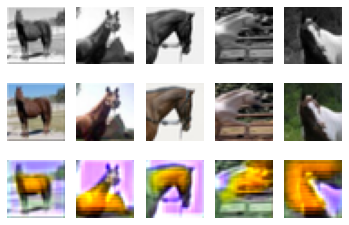

17 tensor(1.7457) tensor(0.7696)


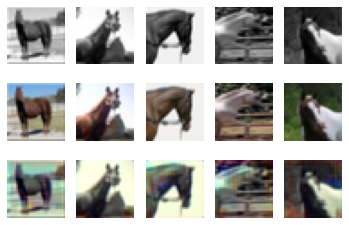

18 tensor(4.9543) tensor(0.0520)


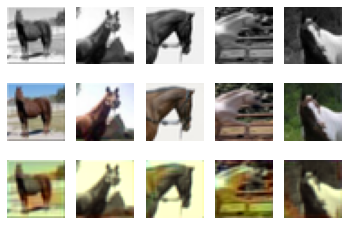

19 tensor(4.8804) tensor(0.3419)


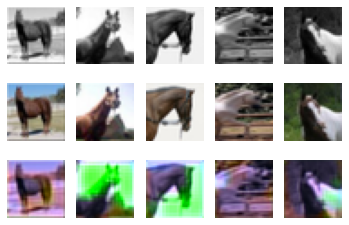

20 tensor(1.8519) tensor(0.4399)


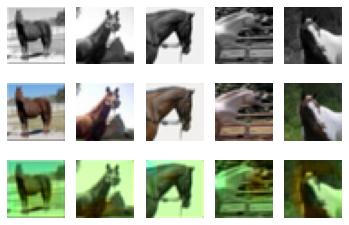

21 tensor(4.4306) tensor(0.2086)


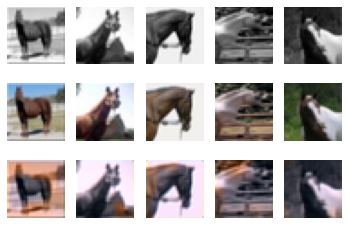

22 tensor(5.1697) tensor(0.0390)


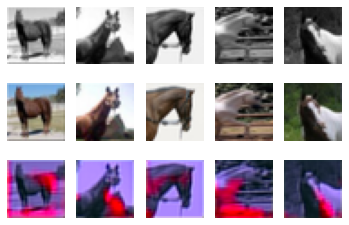

23 tensor(2.8460) tensor(0.3748)


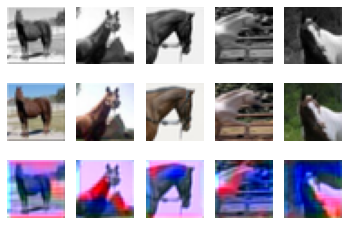

24 tensor(1.8615) tensor(0.6895)


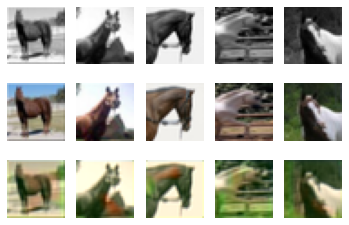

25 tensor(2.7179) tensor(0.4046)


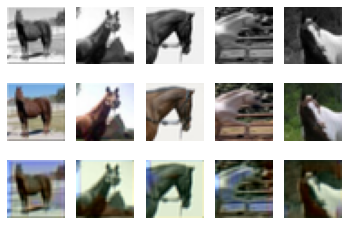

26 tensor(2.5583) tensor(0.4573)


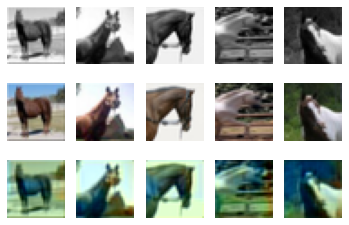

27 tensor(4.4800) tensor(0.0760)


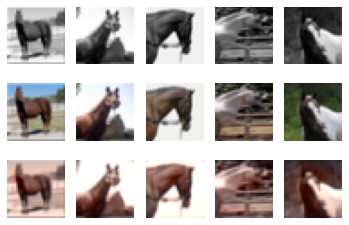

28 tensor(2.5570) tensor(1.0327)


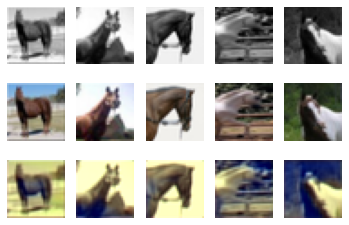

29 tensor(2.5497) tensor(0.8205)


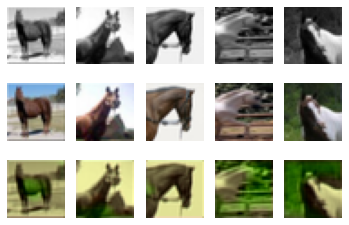

30 tensor(5.0957) tensor(0.0441)


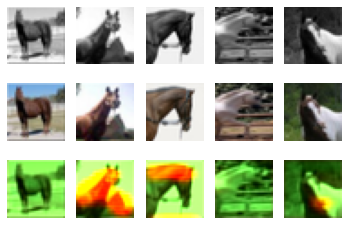

31 tensor(5.2413) tensor(0.0502)


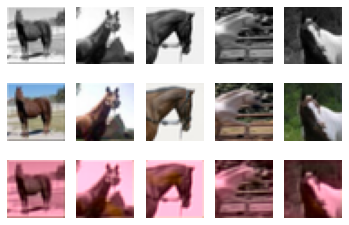

32 tensor(5.6092) tensor(0.0592)


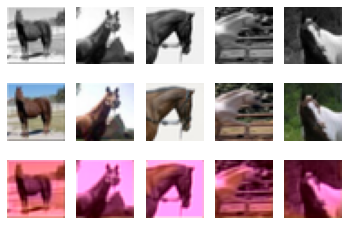

33 tensor(3.1354) tensor(0.1912)


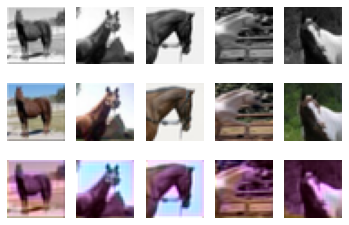

34 tensor(3.7388) tensor(0.8415)


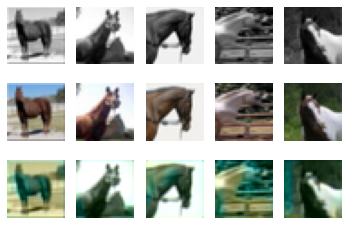

35 tensor(4.3935) tensor(0.1673)


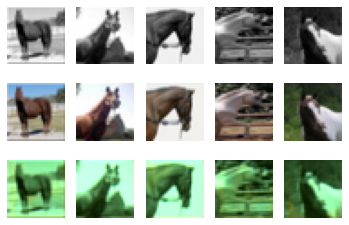

36 tensor(3.3599) tensor(0.4689)


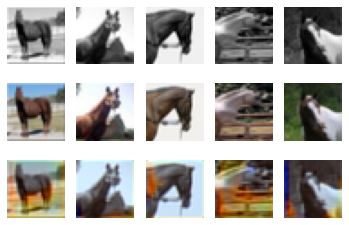

37 tensor(6.1782) tensor(0.2517)


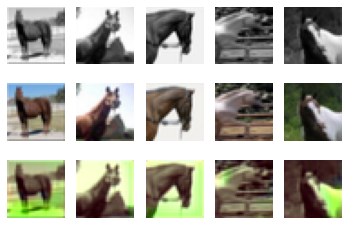

38 tensor(2.9043) tensor(0.3165)


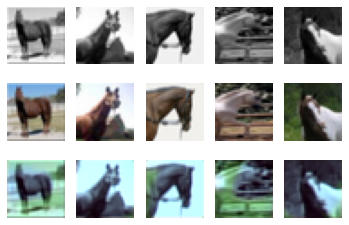

39 tensor(4.3476) tensor(0.1518)


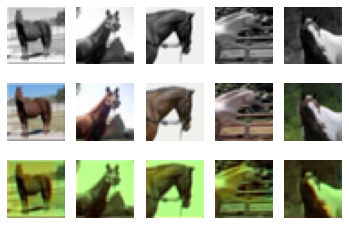

40 tensor(2.9532) tensor(1.4279)


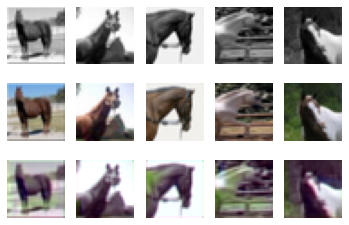

41 tensor(2.3602) tensor(1.0552)


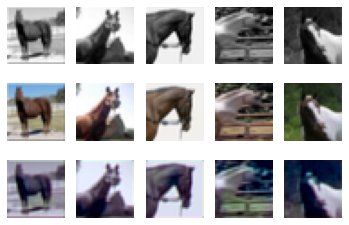

42 tensor(4.1386) tensor(0.0582)


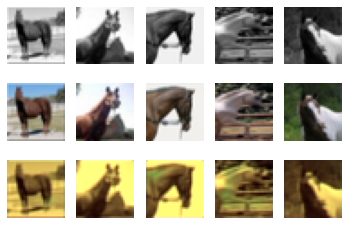

43 tensor(3.9238) tensor(0.1038)


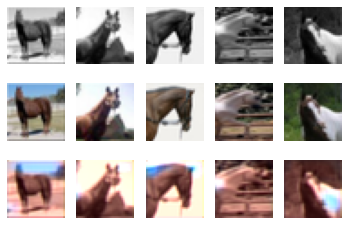

44 tensor(3.5284) tensor(0.3563)


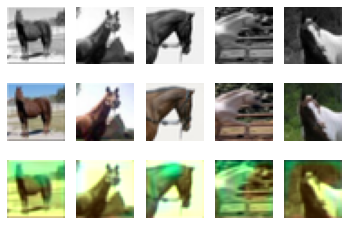

45 tensor(3.3813) tensor(0.1792)


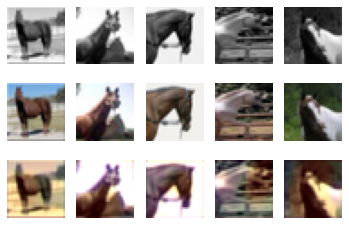

46 tensor(3.3990) tensor(0.2074)


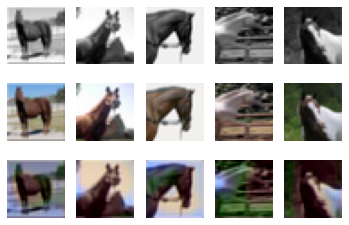

47 tensor(2.9706) tensor(0.2226)


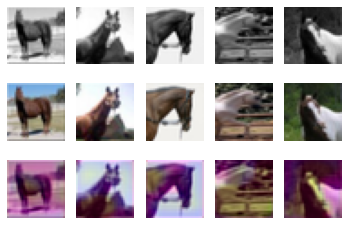

48 tensor(2.8548) tensor(0.2816)


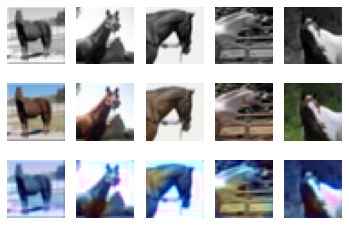

49 tensor(4.1296) tensor(0.0612)


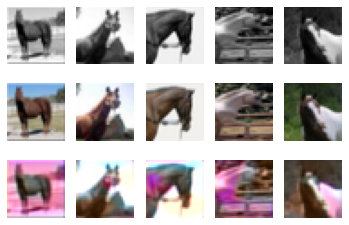

50 tensor(3.1038) tensor(0.5760)


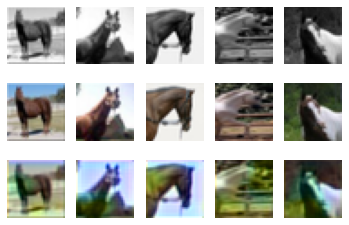

51 tensor(2.9235) tensor(0.5172)


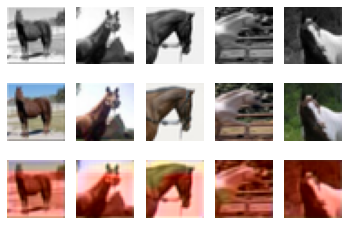

52 tensor(2.3785) tensor(0.4273)


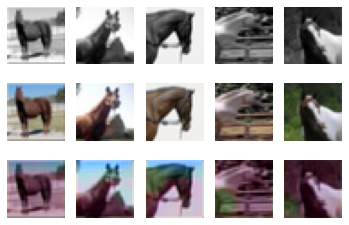

53 tensor(3.6118) tensor(0.2345)


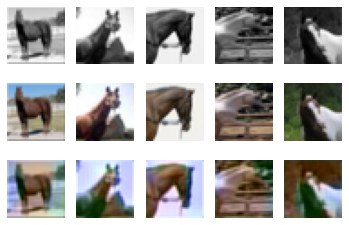

54 tensor(4.0992) tensor(0.3676)


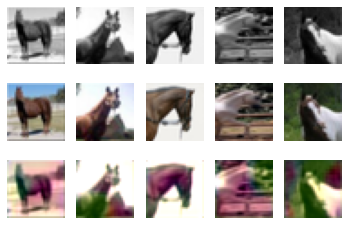

55 tensor(2.6166) tensor(0.7608)


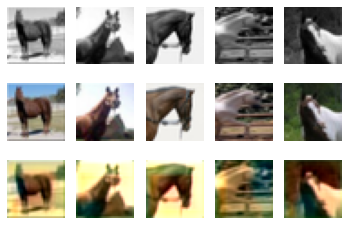

56 tensor(2.3017) tensor(0.7517)


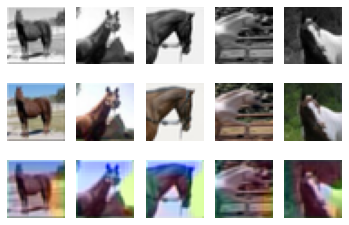

57 tensor(3.0841) tensor(0.9114)


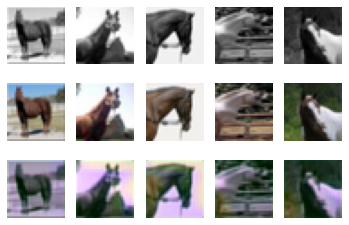

58 tensor(5.3241) tensor(0.4929)


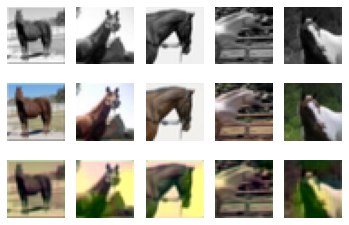

59 tensor(3.4110) tensor(0.9747)


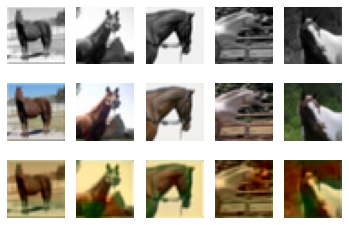

60 tensor(3.0922) tensor(0.3105)


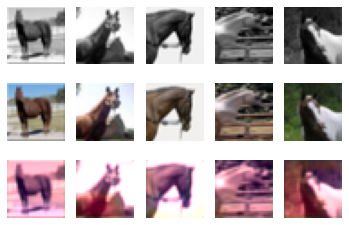

61 tensor(1.8752) tensor(1.5135)


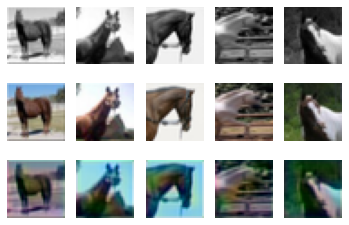

62 tensor(1.7723) tensor(0.7690)


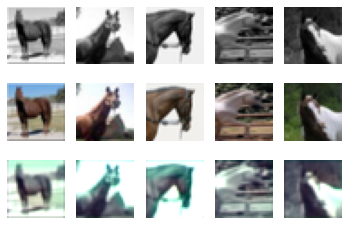

63 tensor(2.1636) tensor(1.0113)


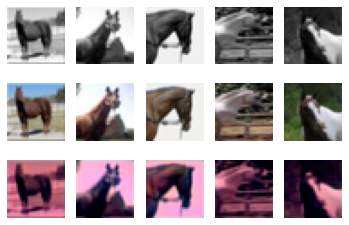

64 tensor(3.9390) tensor(0.0729)


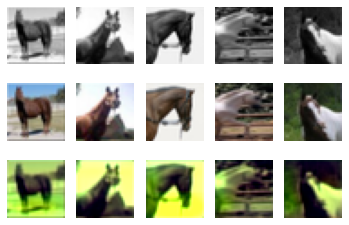

65 tensor(4.3831) tensor(0.2024)


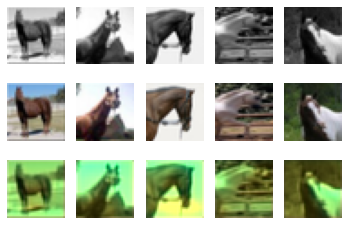

66 tensor(4.0114) tensor(0.0652)


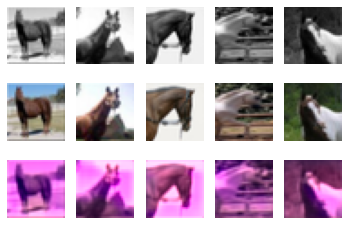

67 tensor(4.1751) tensor(0.1573)


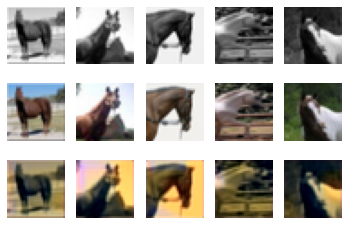

68 tensor(3.3633) tensor(0.3589)


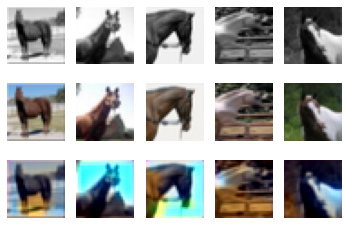

69 tensor(3.7271) tensor(0.2597)


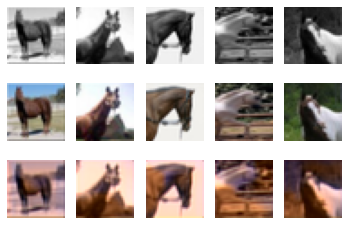

70 tensor(3.5901) tensor(0.4068)


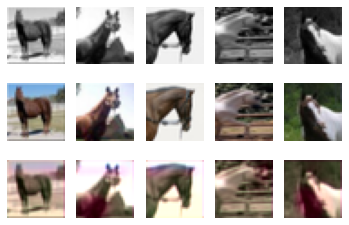

71 tensor(2.4842) tensor(0.7220)


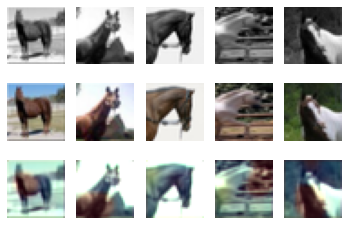

72 tensor(3.6629) tensor(0.2253)


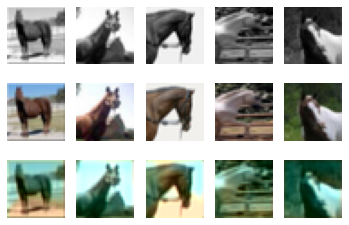

73 tensor(5.3810) tensor(0.1051)


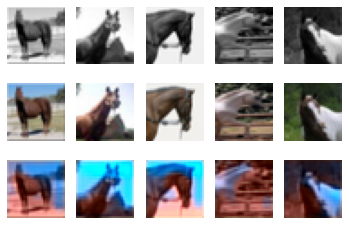

74 tensor(3.2832) tensor(0.3011)


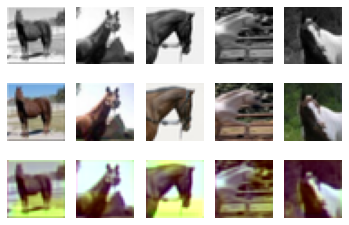

75 tensor(2.8615) tensor(0.1068)


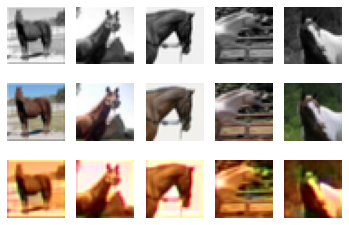

76 tensor(3.7920) tensor(0.4399)


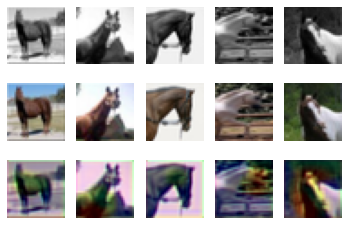

77 tensor(4.1108) tensor(0.1065)


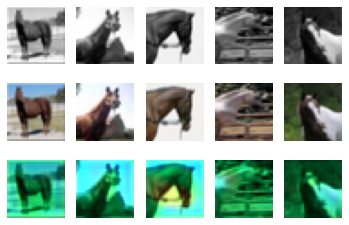

78 tensor(4.3422) tensor(0.1063)


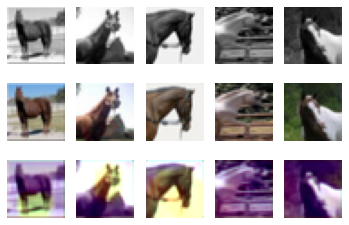

79 tensor(2.8453) tensor(0.3727)


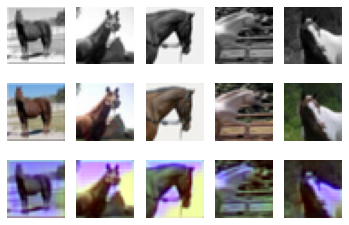

80 tensor(2.3193) tensor(0.8291)


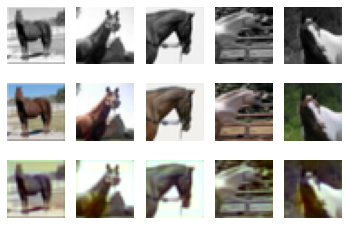

81 tensor(3.9340) tensor(0.1359)


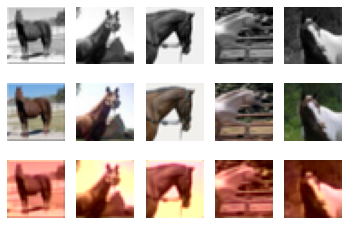

82 tensor(6.5656) tensor(0.2071)


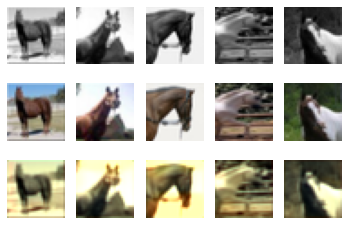

83 tensor(2.8239) tensor(0.4292)


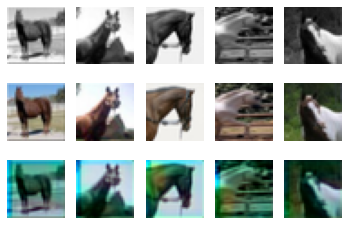

84 tensor(5.0200) tensor(0.0686)


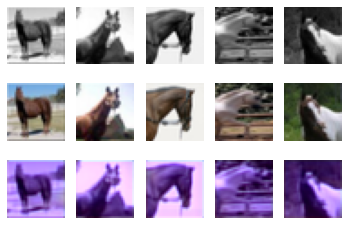

85 tensor(6.2832) tensor(0.0160)


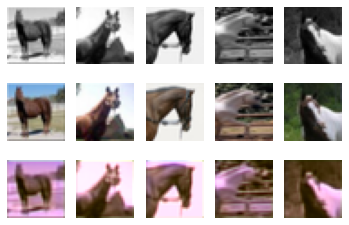

86 tensor(4.2067) tensor(0.2959)


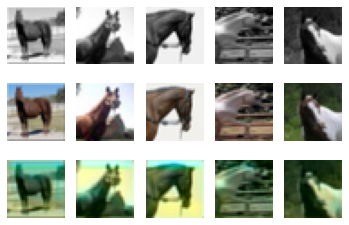

87 tensor(4.7259) tensor(0.4547)


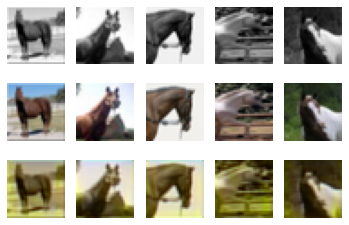

88 tensor(4.5478) tensor(0.2024)


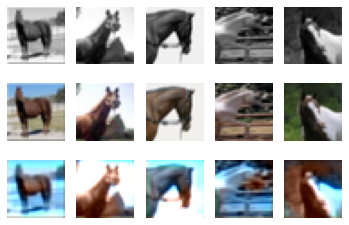

89 tensor(2.7495) tensor(0.5739)


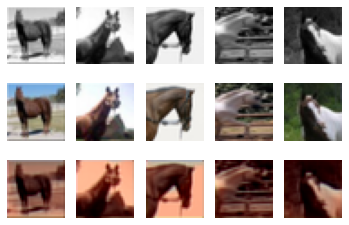

90 tensor(3.1212) tensor(0.2529)


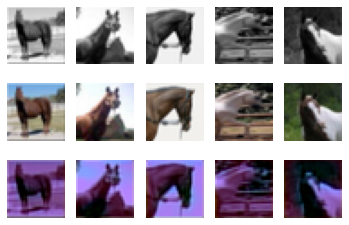

91 tensor(3.5940) tensor(0.3677)


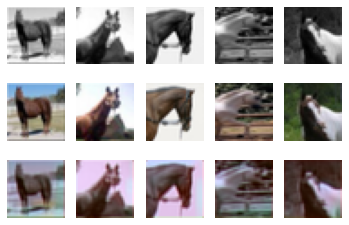

92 tensor(4.3927) tensor(0.1331)


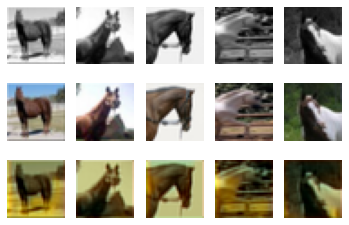

93 tensor(2.6935) tensor(0.3896)


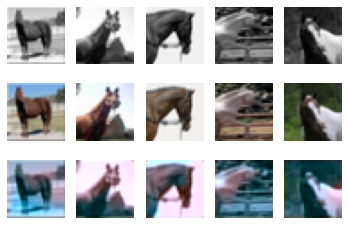

94 tensor(4.6134) tensor(0.0884)


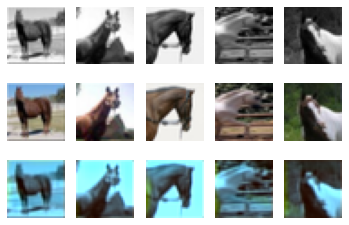

95 tensor(3.3270) tensor(0.5280)


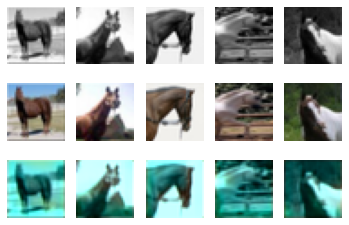

96 tensor(1.9910) tensor(0.4636)


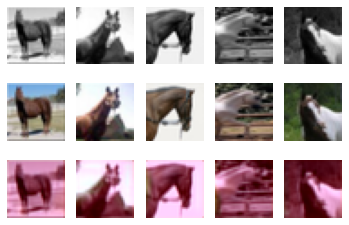

97 tensor(3.4296) tensor(0.1361)


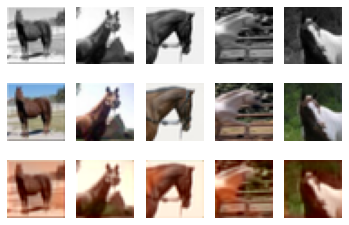

98 tensor(1.4201) tensor(1.6195)


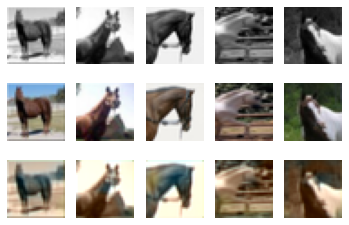

99 tensor(1.9585) tensor(1.1725)


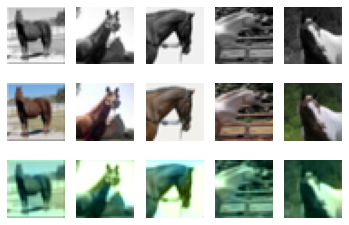

In [38]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 16,
    'g_learn_rate':0.001,
    'd_learn_rate':0.001,
    "batch_size": 50,
    "epochs": 100,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": True,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(0.8130) tensor(1.5267)


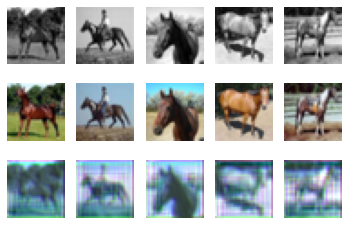

1 tensor(0.8628) tensor(1.4008)


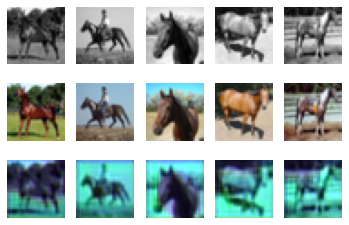

2 tensor(1.2873) tensor(1.1688)


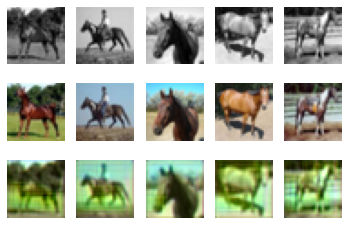

3 tensor(1.0693) tensor(1.1338)


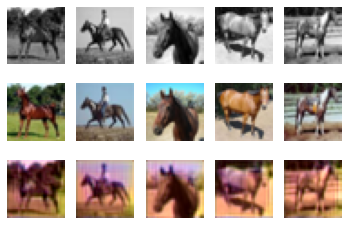

4 tensor(0.8921) tensor(1.2785)


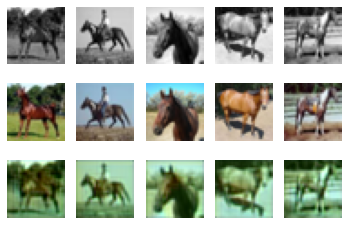

5 tensor(1.4988) tensor(1.0691)


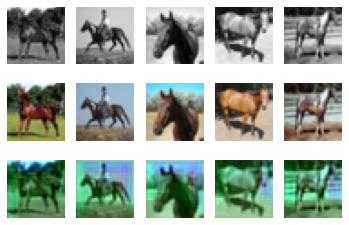

6 tensor(1.7419) tensor(0.4580)


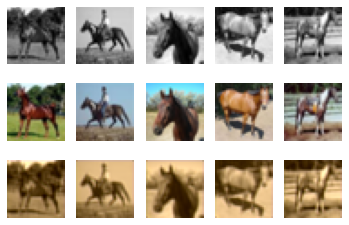

7 tensor(1.1614) tensor(1.1446)


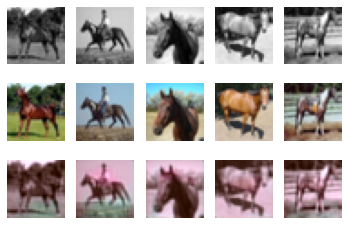

8 tensor(2.4734) tensor(0.2823)


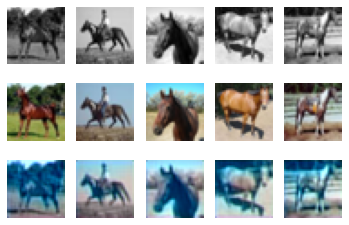

9 tensor(1.0885) tensor(1.2287)


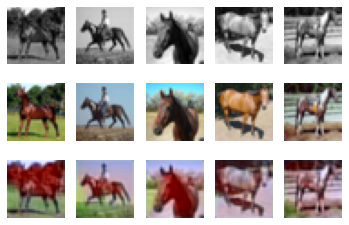

10 tensor(1.2406) tensor(1.1647)


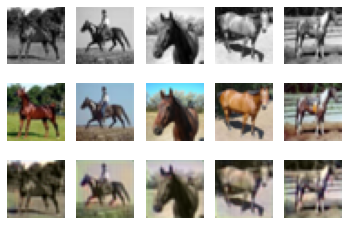

11 tensor(2.8776) tensor(0.8158)


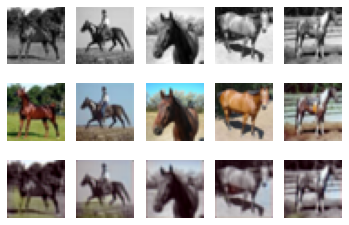

12 tensor(1.4353) tensor(0.7633)


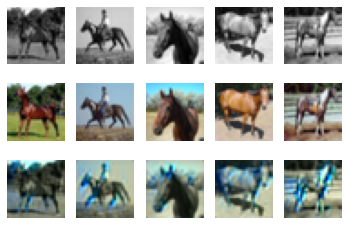

13 tensor(2.5641) tensor(0.2933)


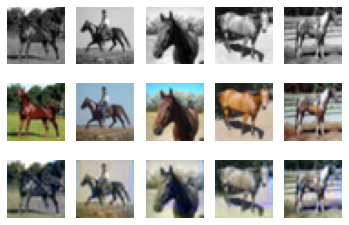

14 tensor(1.4102) tensor(0.7929)


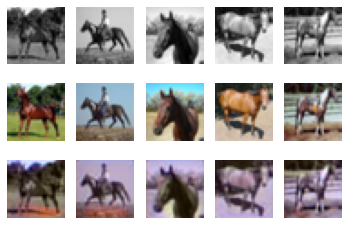

15 tensor(1.6275) tensor(0.9609)


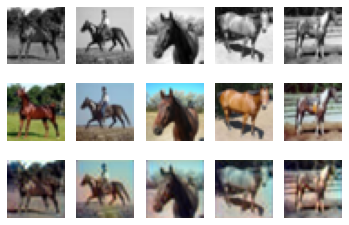

16 tensor(1.6298) tensor(0.6382)


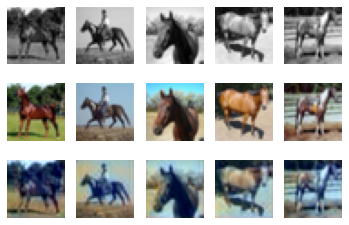

17 tensor(2.6642) tensor(0.4655)


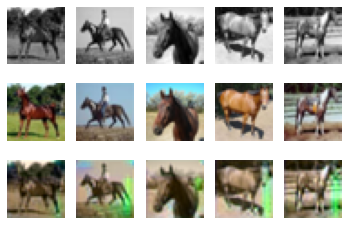

18 tensor(2.5537) tensor(0.5908)


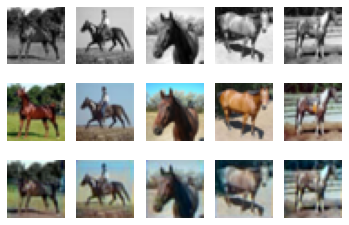

19 tensor(3.4249) tensor(0.1819)


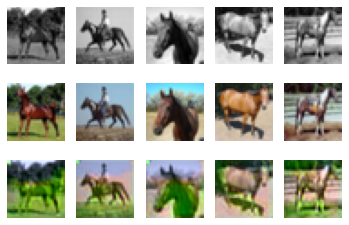

20 tensor(2.3529) tensor(0.3487)


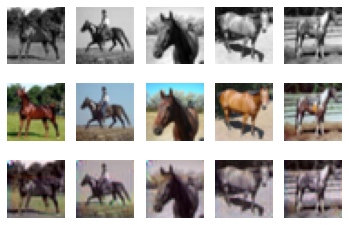

21 tensor(2.2334) tensor(0.4416)


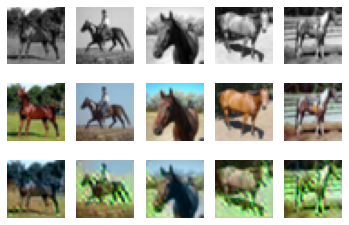

22 tensor(2.3293) tensor(0.2959)


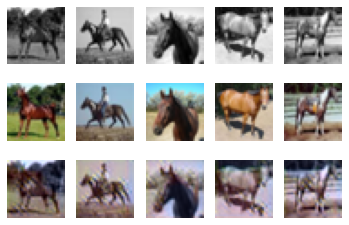

23 tensor(3.3656) tensor(0.1788)


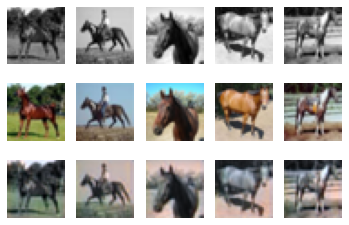

24 tensor(3.7637) tensor(0.1185)


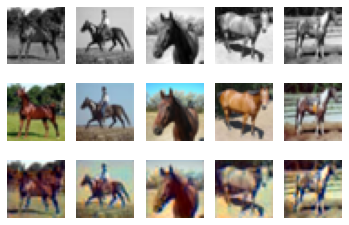

25 tensor(3.1643) tensor(0.2053)


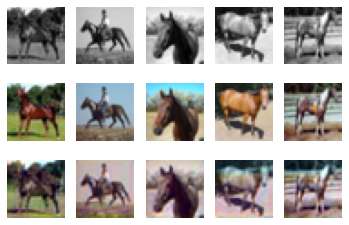

26 tensor(3.8226) tensor(0.2530)


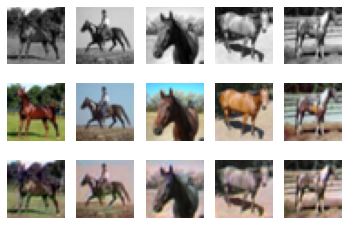

27 tensor(3.1865) tensor(0.1810)


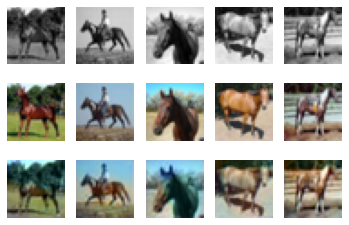

28 tensor(3.9192) tensor(0.0818)


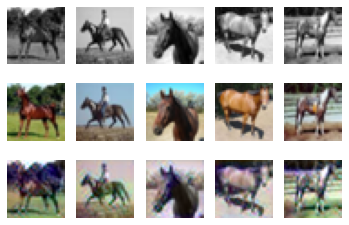

29 tensor(1.7241) tensor(0.8395)


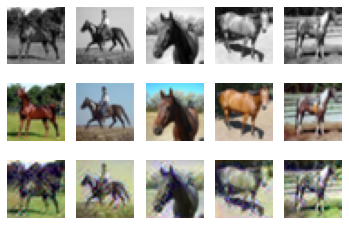

30 tensor(3.5905) tensor(0.6812)


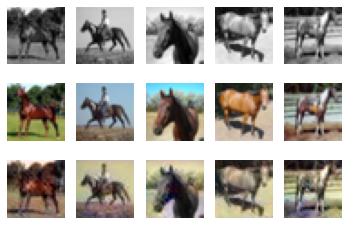

31 tensor(3.3967) tensor(0.2086)


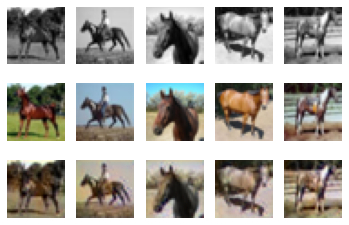

32 tensor(2.6721) tensor(0.1836)


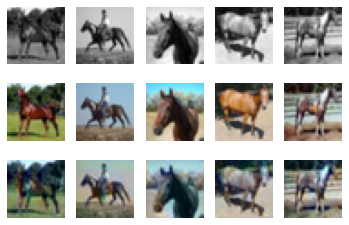

33 tensor(2.1255) tensor(1.0116)


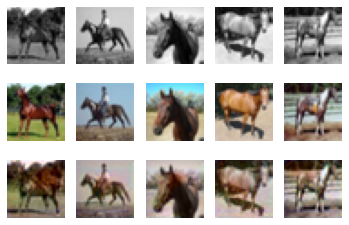

34 tensor(2.5518) tensor(0.2638)


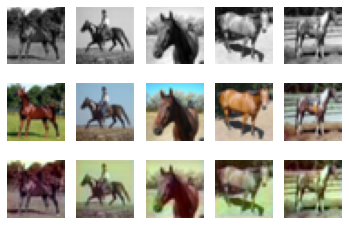

35 tensor(1.6784) tensor(0.5207)


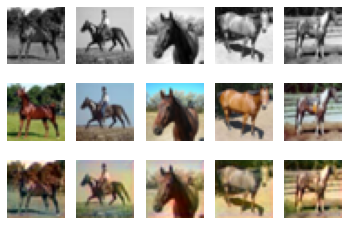

36 tensor(2.7129) tensor(0.2020)


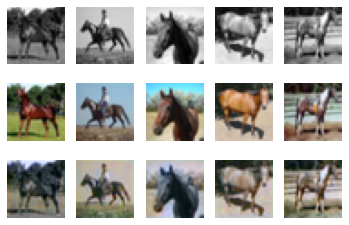

37 tensor(2.3579) tensor(0.3972)


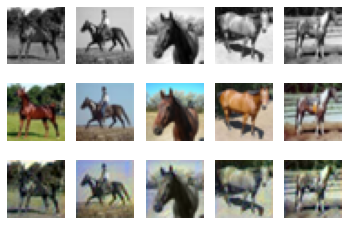

38 tensor(1.6132) tensor(0.5813)


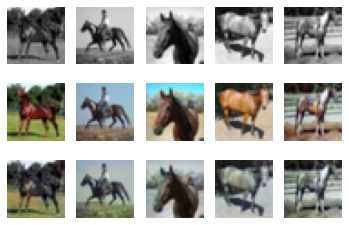

39 tensor(1.8665) tensor(0.4563)


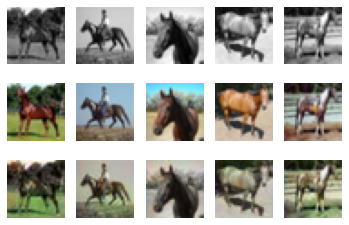

40 tensor(1.8708) tensor(0.6930)


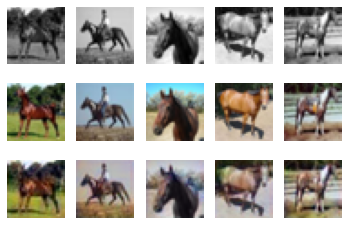

41 tensor(2.4481) tensor(0.3728)


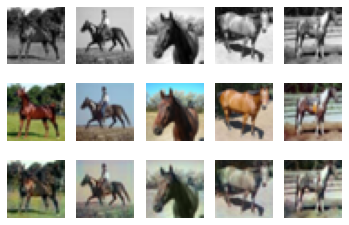

42 tensor(1.1869) tensor(0.9861)


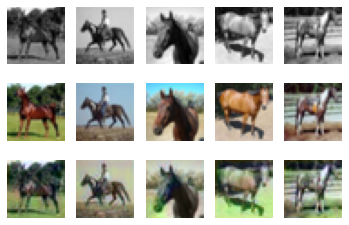

43 tensor(1.3148) tensor(0.7073)


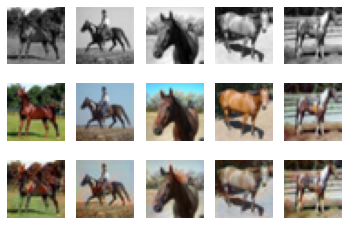

44 tensor(0.9894) tensor(1.0499)


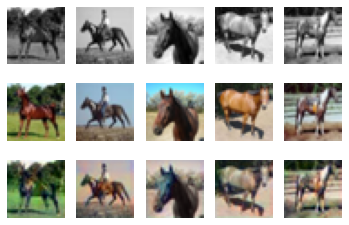

45 tensor(1.8062) tensor(0.4405)


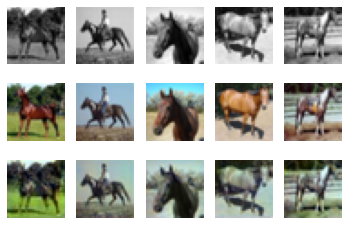

46 tensor(2.7884) tensor(0.3998)


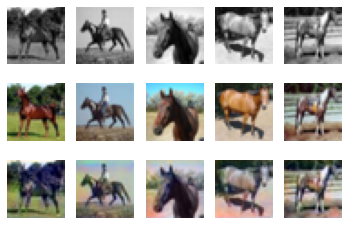

47 tensor(0.9366) tensor(1.3990)


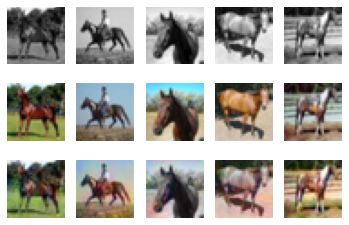

48 tensor(2.0922) tensor(0.4257)


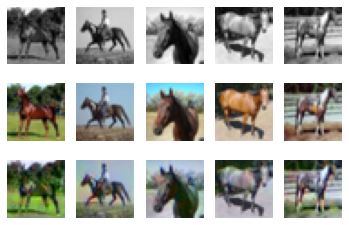

49 tensor(2.4063) tensor(0.2611)


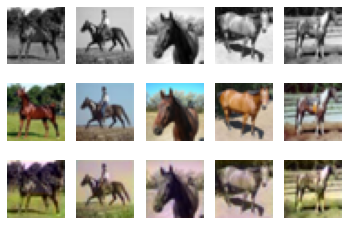

50 tensor(2.2654) tensor(0.6478)


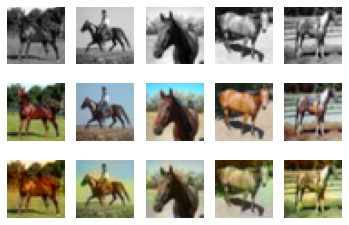

51 tensor(2.2514) tensor(0.2797)


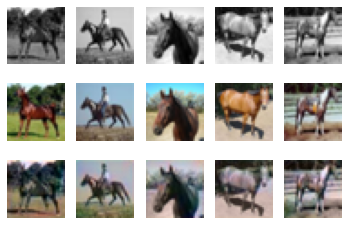

52 tensor(1.7089) tensor(0.6313)


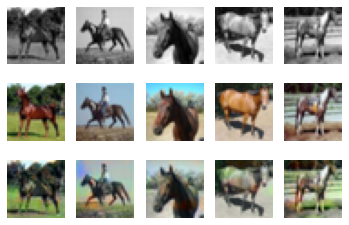

53 tensor(1.4212) tensor(0.6864)


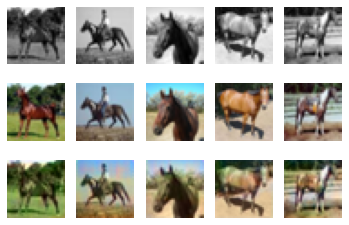

54 tensor(2.2098) tensor(0.7190)


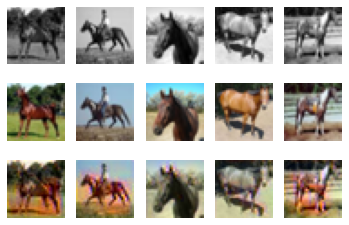

55 tensor(2.6941) tensor(0.2160)


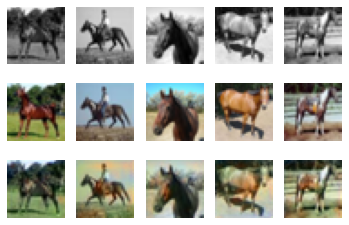

56 tensor(2.6396) tensor(0.1701)


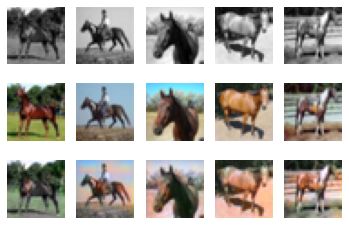

57 tensor(2.8340) tensor(0.3210)


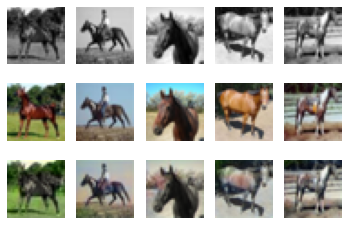

58 tensor(1.3642) tensor(0.6061)


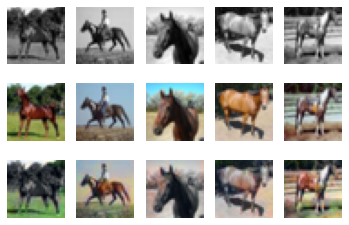

59 tensor(1.5474) tensor(0.7001)


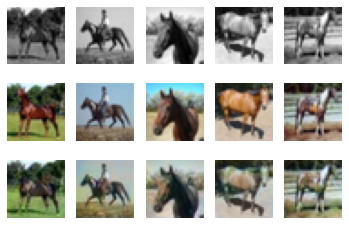

60 tensor(1.4028) tensor(0.8674)


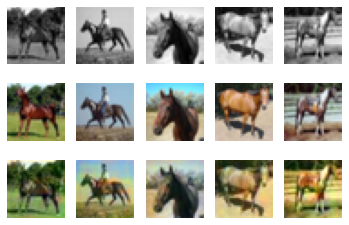

61 tensor(2.5060) tensor(0.4911)


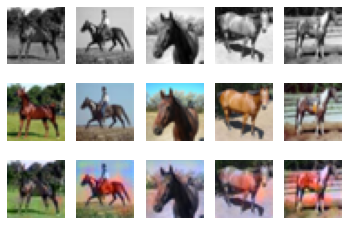

62 tensor(2.9427) tensor(0.5483)


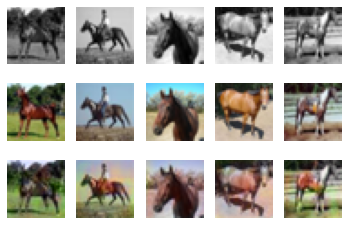

63 tensor(2.1063) tensor(1.0502)


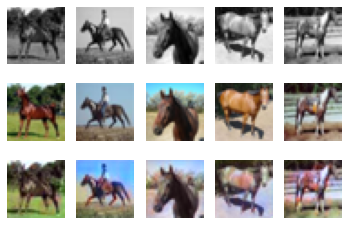

64 tensor(2.3251) tensor(0.6022)


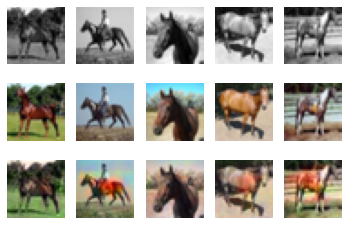

65 tensor(1.7092) tensor(0.7976)


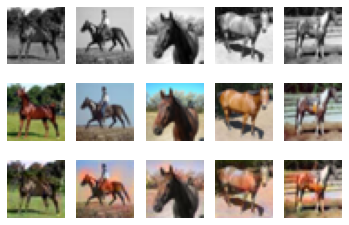

66 tensor(2.6792) tensor(0.4269)


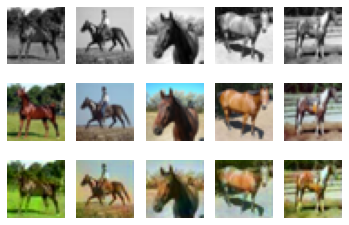

67 tensor(2.0264) tensor(0.4497)


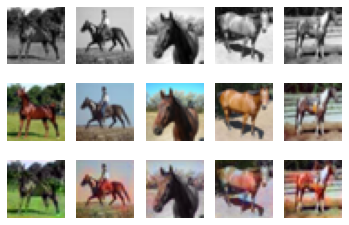

68 tensor(1.5408) tensor(0.6151)


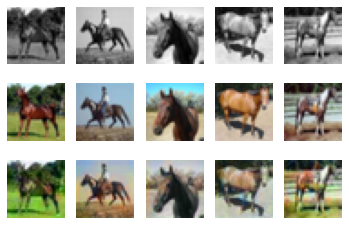

69 tensor(1.9439) tensor(0.5764)


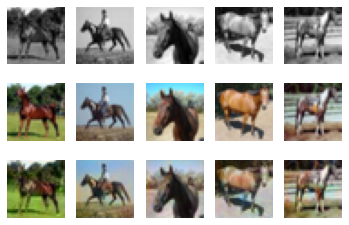

70 tensor(1.4541) tensor(0.6305)


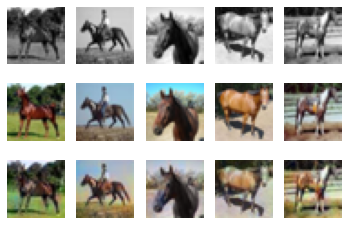

71 tensor(3.6382) tensor(0.1739)


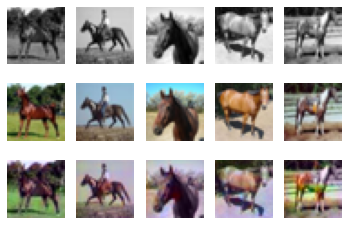

72 tensor(2.7983) tensor(0.2779)


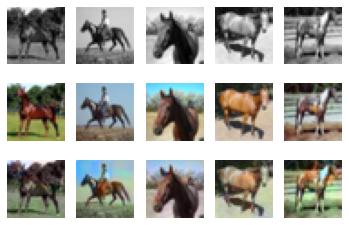

73 tensor(2.7169) tensor(0.3868)


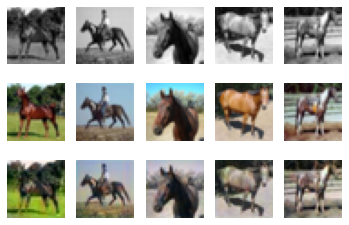

74 tensor(1.4334) tensor(0.5496)


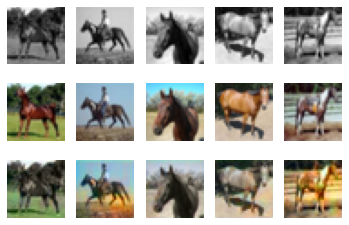

75 tensor(3.2256) tensor(0.4585)


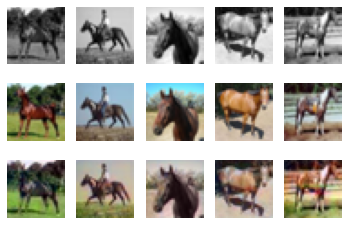

76 tensor(1.8109) tensor(0.3672)


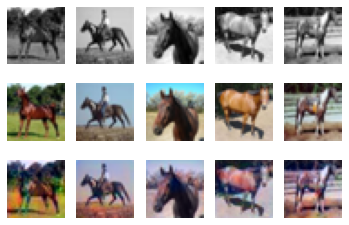

77 tensor(2.7079) tensor(0.3500)


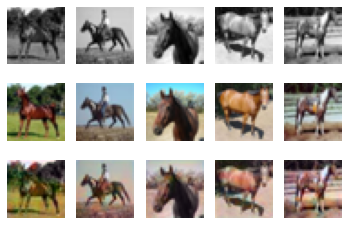

78 tensor(1.4898) tensor(0.7682)


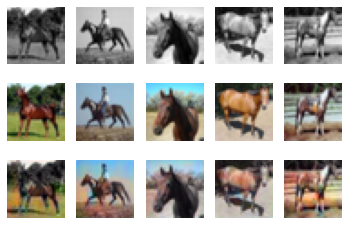

79 tensor(3.7546) tensor(0.1073)


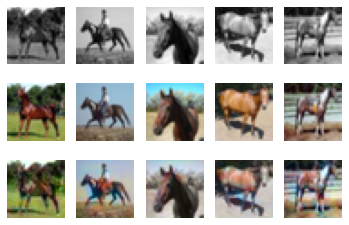

80 tensor(2.7874) tensor(0.6795)


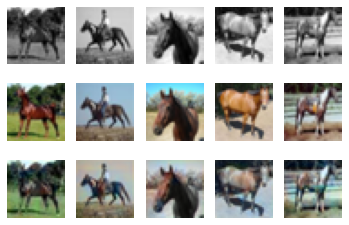

81 tensor(2.9369) tensor(0.2355)


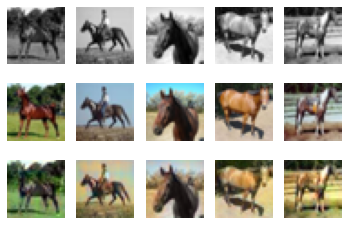

82 tensor(2.4795) tensor(0.2981)


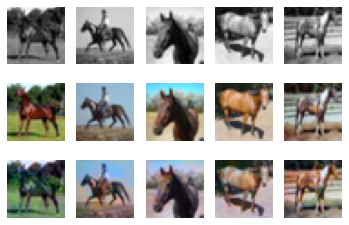

83 tensor(2.1003) tensor(0.4757)


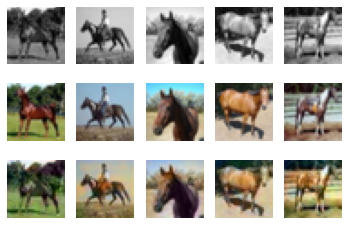

84 tensor(2.1209) tensor(0.4609)


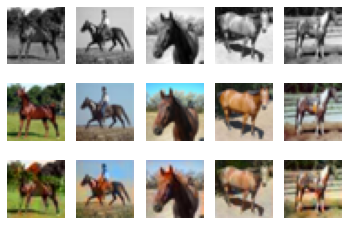

85 tensor(2.5589) tensor(0.4503)


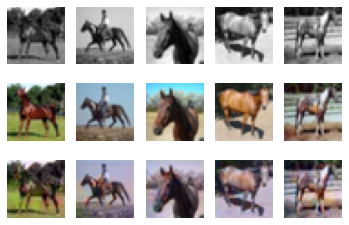

86 tensor(2.5611) tensor(0.1540)


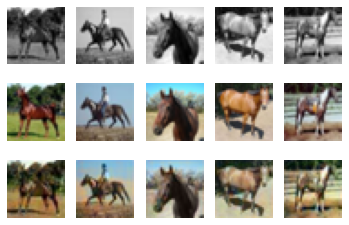

87 tensor(3.3698) tensor(0.7954)


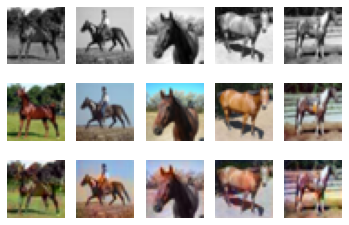

88 tensor(4.5740) tensor(0.5048)


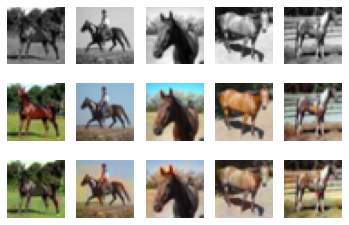

89 tensor(3.7137) tensor(0.2948)


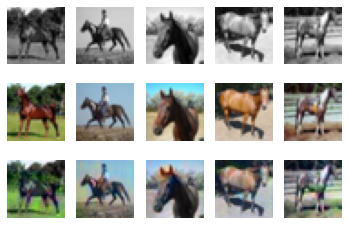

90 tensor(2.7545) tensor(0.2661)


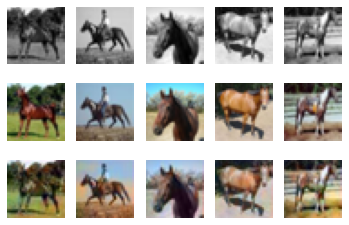

91 tensor(2.7082) tensor(0.2547)


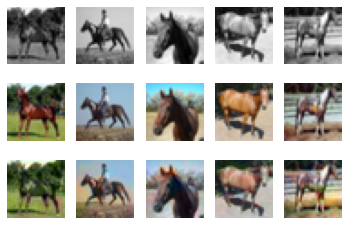

92 tensor(3.5537) tensor(0.1900)


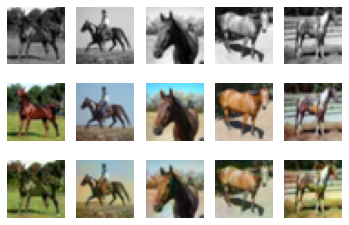

93 tensor(2.9642) tensor(0.3552)


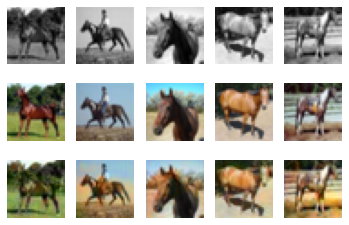

94 tensor(2.4760) tensor(0.5451)


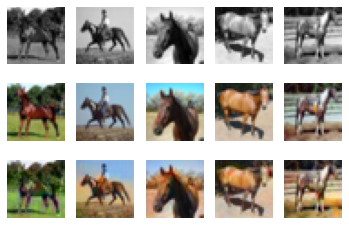

95 tensor(3.4486) tensor(0.2796)


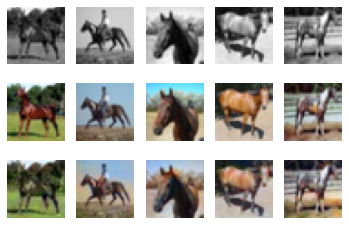

96 tensor(6.6631) tensor(0.0321)


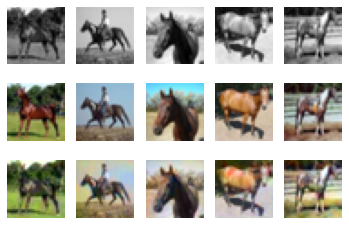

97 tensor(3.5095) tensor(0.2283)


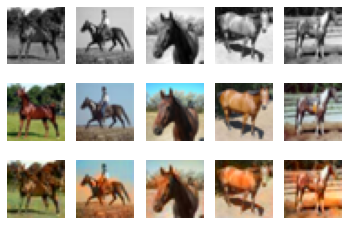

98 tensor(2.9876) tensor(0.1810)


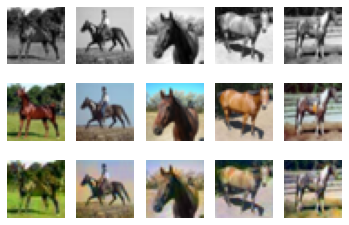

99 tensor(2.8957) tensor(0.3702)


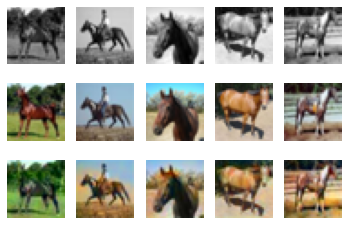

100 tensor(3.6099) tensor(0.7879)


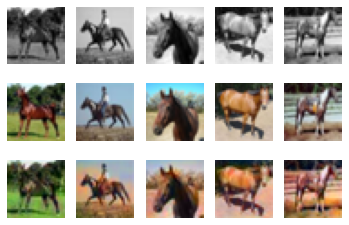

101 tensor(3.4627) tensor(0.2727)


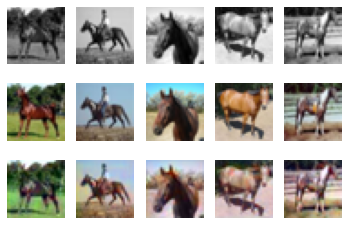

102 tensor(2.4333) tensor(0.3562)


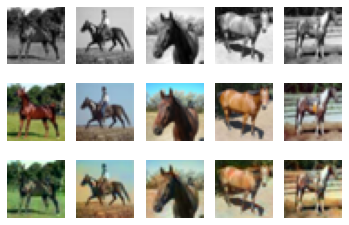

103 tensor(1.6251) tensor(0.5764)


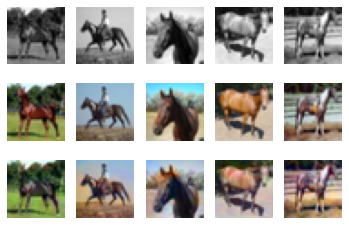

104 tensor(2.2055) tensor(0.3476)


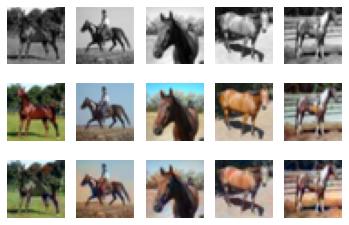

105 tensor(1.8040) tensor(0.3497)


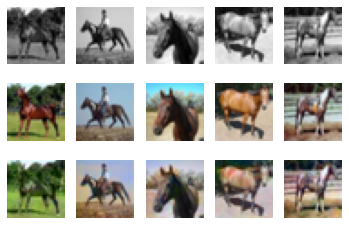

106 tensor(1.9242) tensor(0.4961)


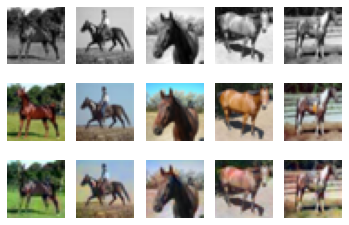

107 tensor(2.1525) tensor(0.5646)


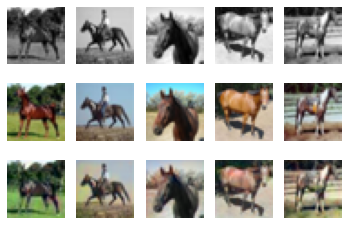

108 tensor(1.5297) tensor(0.4490)


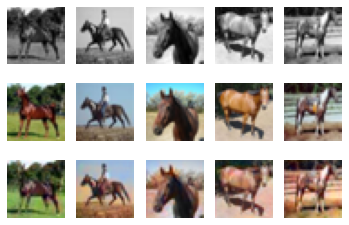

109 tensor(1.8497) tensor(0.4291)


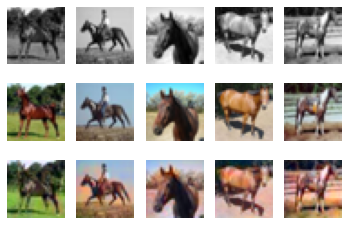

110 tensor(2.4472) tensor(0.1407)


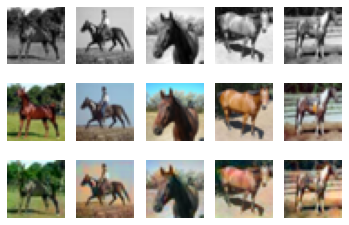

111 tensor(2.8963) tensor(0.1649)


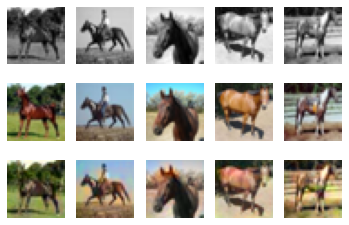

112 tensor(2.6945) tensor(0.2369)


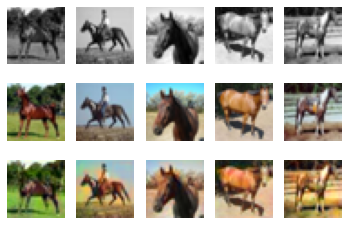

113 tensor(3.7679) tensor(0.1644)


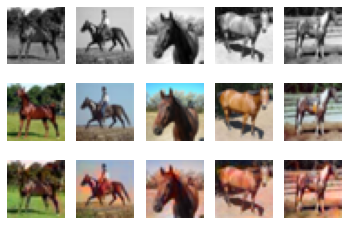

114 tensor(4.1913) tensor(0.0679)


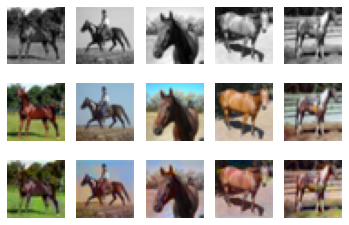

115 tensor(1.9179) tensor(0.3873)


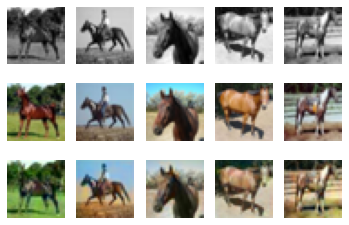

116 tensor(1.4969) tensor(0.7322)


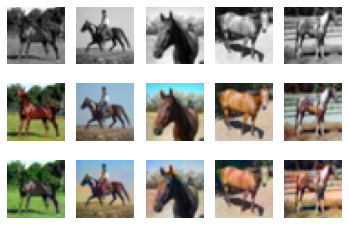

117 tensor(1.1393) tensor(0.5109)


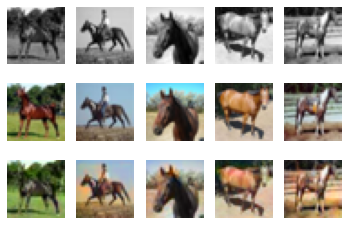

118 tensor(2.1413) tensor(0.1427)


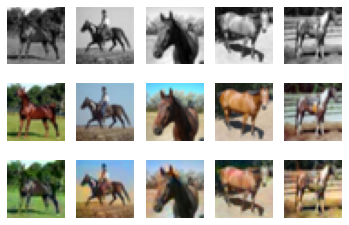

119 tensor(2.3415) tensor(0.1955)


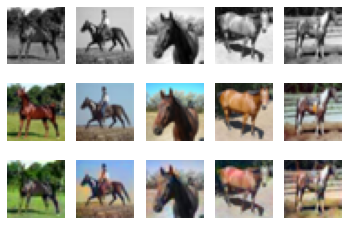

120 tensor(2.6146) tensor(0.2893)


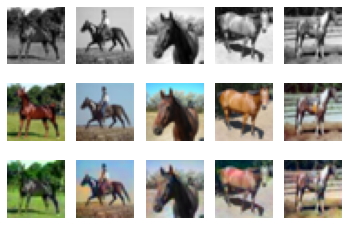

121 tensor(2.8249) tensor(0.2545)


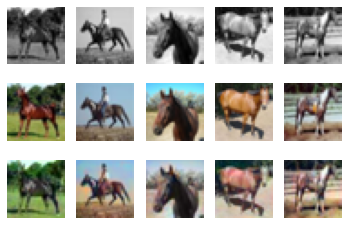

122 tensor(4.3248) tensor(0.4009)


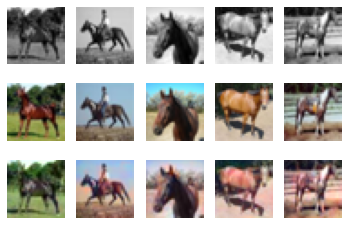

123 tensor(2.8187) tensor(0.2326)


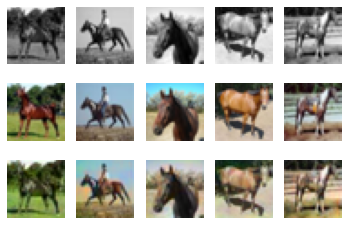

124 tensor(4.0918) tensor(0.1755)


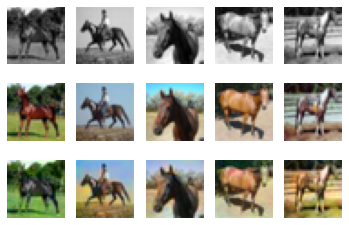

125 tensor(4.1983) tensor(0.7499)


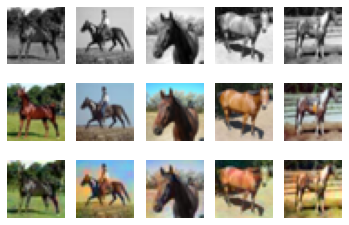

126 tensor(3.9321) tensor(0.5659)


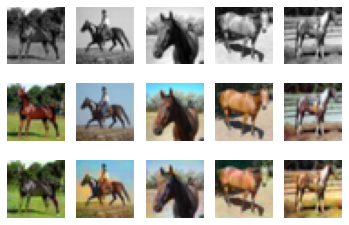

127 tensor(4.0872) tensor(0.2252)


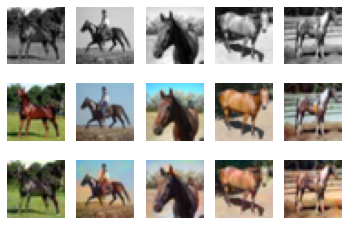

128 tensor(4.5049) tensor(0.6051)


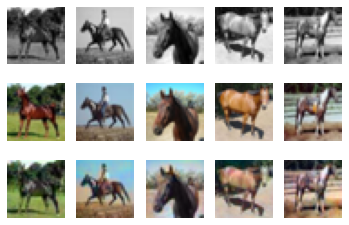

129 tensor(4.7033) tensor(0.4226)


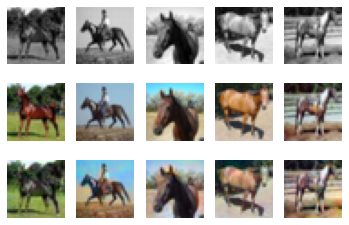

130 tensor(4.3923) tensor(0.1631)


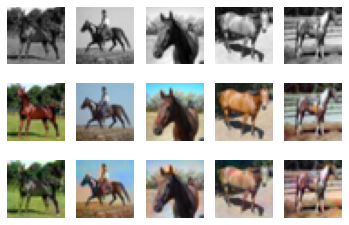

131 tensor(3.7380) tensor(0.1855)


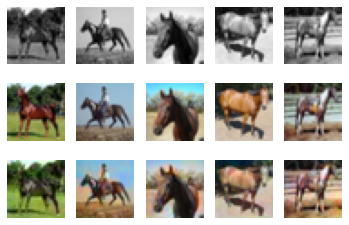

132 tensor(3.8169) tensor(0.1236)


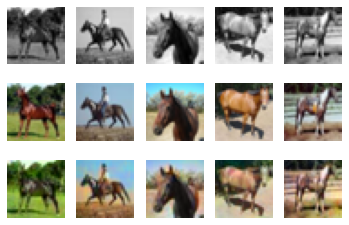

133 tensor(3.7367) tensor(0.1394)


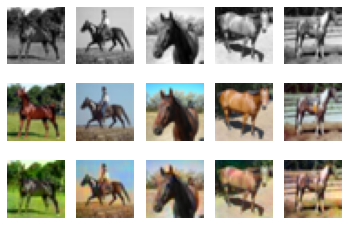

134 tensor(3.6856) tensor(0.1578)


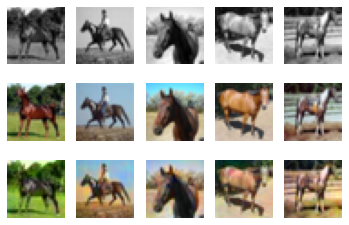

135 tensor(3.3036) tensor(0.2219)


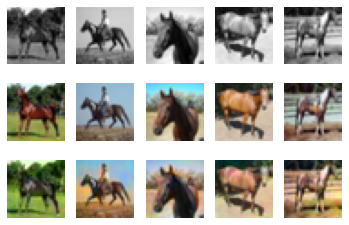

136 tensor(3.3676) tensor(0.1418)


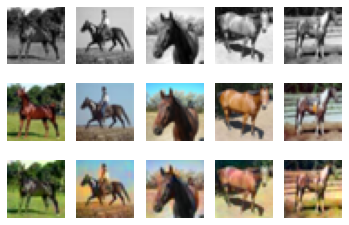

137 tensor(3.3492) tensor(0.1048)


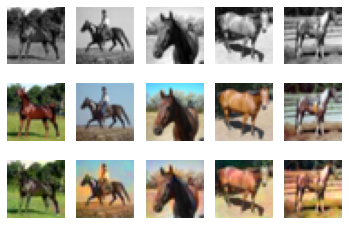

138 tensor(3.6747) tensor(0.0957)


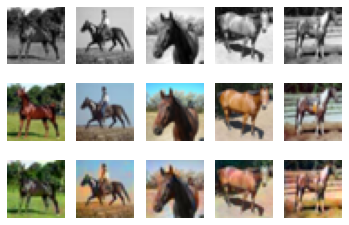

139 tensor(6.3400) tensor(0.0493)


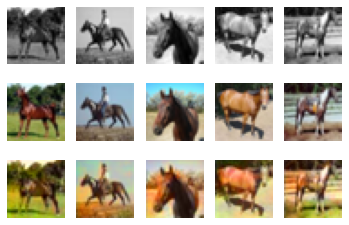

140 tensor(2.9803) tensor(0.1586)


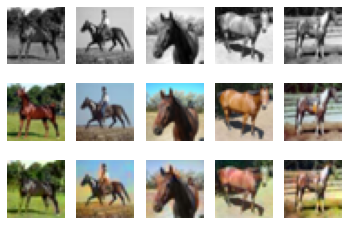

141 tensor(3.4326) tensor(0.1432)


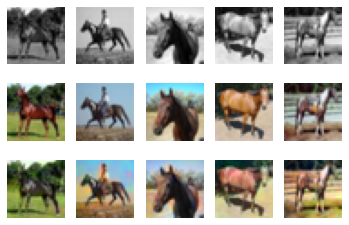

142 tensor(3.5092) tensor(0.1427)


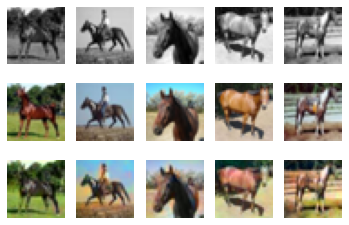

143 tensor(2.9713) tensor(0.1627)


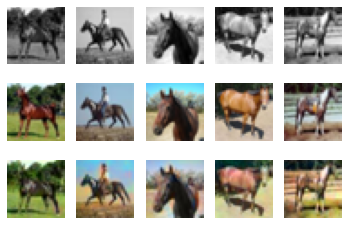

144 tensor(3.5275) tensor(0.1262)


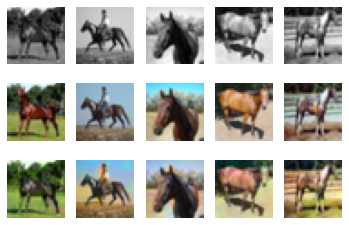

145 tensor(5.1647) tensor(0.1648)


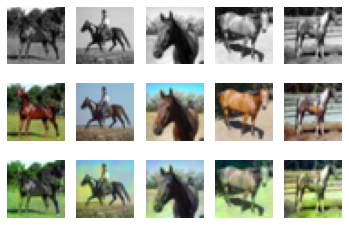

146 tensor(3.4469) tensor(0.1310)


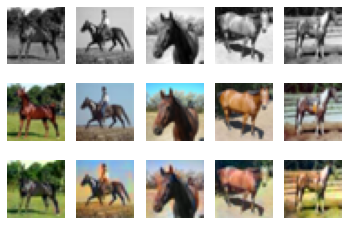

147 tensor(3.2550) tensor(0.1131)


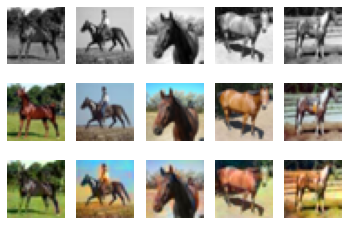

148 tensor(2.8427) tensor(0.1568)


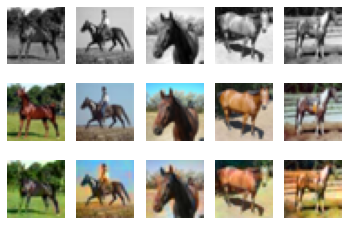

149 tensor(2.5008) tensor(0.1445)


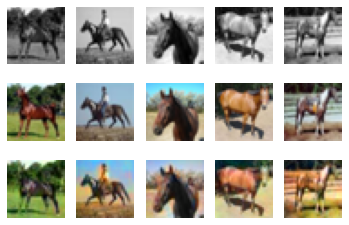

In [40]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'g_learn_rate':0.001,
    'd_learn_rate':0.0001, 
    "batch_size": 25,
    "epochs": 150,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": True,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

## Exploration

*In this section, we are experimenting with pretraining the generator and using L1 loss to the generator inaddition to the BCEloss.*

In [41]:
class UNet(nn.Module):
    def __init__(self, kernel, num_filters, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        #output_padding = 1

        self.downconv1 = nn.Sequential(
          nn.Conv2d(num_in_channels, num_filters, kernel_size = kernel, padding = padding),
          nn.MaxPool2d(2),
          nn.BatchNorm2d(num_filters),
          nn.ReLU())
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters * 2, kernel_size = kernel,padding = padding),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters * 2, num_filters * 2, kernel_size = kernel,
                      padding = padding),
            nn.BatchNorm2d(num_filters * 2),
            nn.ReLU())
        self.upconv1 = nn.Sequential(
            nn.Conv2d(4 * num_filters, num_filters, kernel_size = kernel,
                      padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(num_filters),
            nn.ReLU())
        self.upconv2 = nn.Sequential(
            nn.Conv2d(2 * num_filters, 3, kernel_size = kernel, padding = padding),
            nn.Upsample(scale_factor = 2),
            nn.BatchNorm2d(3),
            nn.ReLU())
        self.finalconv = nn.Conv2d(4, 3, kernel_size = kernel, padding = padding)
        

    def forward(self, x):
        out1 = self.downconv1(x)
        out2 = self.downconv2(out1)
        out3 = self.rfconv(out2)
        out4 = self.upconv1(torch.cat((out2, out3), 1))
        out5 = self.upconv2(torch.cat((out1, out4), 1))
        out = self.finalconv(torch.cat((out5, x), 1))
        return out

In [42]:
# discriminator code

class Discriminator(nn.Module):
    def __init__(self, kernel, num_filters = 8, num_colours=3, num_in_channels=4):
        super().__init__()
        
        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1

        self.disc = nn.Sequential(
            nn.Conv2d(num_in_channels, num_filters , 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters, num_filters*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters*2, num_filters*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(num_filters*4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(num_filters*4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    
    def forward(self, x, img_greyscale):

        img = torch.cat((x,img_greyscale),1)
        out = self.disc(img)
        return out

In [43]:
def get_torch_vars(xs, ys, gpu=True):

    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float()
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

def pretrain(model,batch_size, epochs):

    # LOSS FUNCTION
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train)
    train_losses = []
    valid_losses = []
    valid_accs = []
    print('Begining Training...')
    for epoch in range(epochs):
        # Train the Model
        model.train()  # Change model to 'train' mode
        losses = []
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, batch_size)):
            images, labels = get_torch_vars(xs, ys)
            # Forward + Backward + Optimize
            optimizer.zero_grad()
            outputs = model(images)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            losses.append(loss.data.item())
        
        print(epoch, loss.cpu().detach())

    return model

In [44]:
model = UNet(3,32)
model.cuda()
pretrained_model = pretrain(model,50,10) #try 50 batch size if not working

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Begining Training...
0 tensor(0.0201)
1 tensor(0.0136)
2 tensor(0.0109)
3 tensor(0.0095)
4 tensor(0.0088)
5 tensor(0.0082)
6 tensor(0.0077)
7 tensor(0.0072)
8 tensor(0.0070)
9 tensor(0.0067)


In [45]:
torch.save(pretrained_model.state_dict(), "unet.pt")

In [46]:
pretrained_Unet = UNet(3,32)
pretrained_Unet.cuda()
pretrained_Unet.load_state_dict(torch.load("/content/a3/unet.pt"))

<All keys matched successfully>

In [68]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float() 
    if gpu:
        xs = xs.cuda()
        ys = ys.cuda()
    return Variable(xs), Variable(ys)

# select a single category.
HORSE_CATEGORY = 7

# convert colour images into greyscale
def process(xs, ys, max_pixel=256.0, downsize_input=False):

    xs = xs / max_pixel
    xs = xs[np.where(ys == HORSE_CATEGORY)[0], :, :, :]
    npr.shuffle(xs)

    grey = np.mean(xs, axis=1, keepdims=True)

    return (xs, grey)


def train(args, cnn=None):

    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOSS FUNCTION
    discriminator = Discriminator(args.kernel, args.num_filters)
    g_criterion = nn.L1Loss().cuda(args.gpu) 
    criterion = nn.BCELoss().cuda(args.gpu)                                                     
    g_optimizer = torch.optim.Adam(cnn.parameters(), lr=args.g_learn_rate)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=args.d_learn_rate)

    # DATA
    print("Loading data...")
    (x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    discriminator.cuda()
    print("Beginning training ...")
        
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)

            img_grey = images
            img_real = labels
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()
            real_validity = discriminator(img_real,img_grey)
            real_loss = criterion((real_validity).squeeze(), 
                                  Variable(torch.zeros(len(real_validity))).cuda())

            fake_images = cnn(img_grey)

            fake_validity = discriminator(fake_images,img_grey)
            fake_loss = criterion((fake_validity).squeeze(),
                                  Variable(torch.ones(len(fake_validity))).cuda())
            
            d_loss = (real_loss + fake_loss)
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            fake_images = cnn(img_grey)
            validity = discriminator(fake_images,img_grey)
            g_loss1 = criterion((validity).squeeze(), Variable(torch.zeros(len(validity))).cuda())
            gen_loss = g_criterion(fake_images,img_real)

            g_loss = (g_loss1 + 100*gen_loss)        
            g_loss.backward()
            g_optimizer.step()

        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        visual(img_grey, img_real, fake_images, args.gpu, 1)
    
    return cnn

Loading data...
File path: data/cifar-10-batches-py.tar.gz
Transforming data...
Beginning training ...
0 tensor(5.4059) tensor(0.9308)


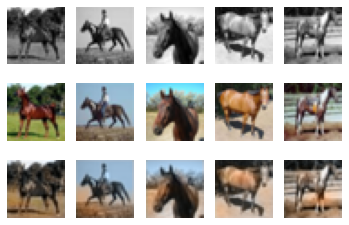

1 tensor(5.8223) tensor(0.7591)


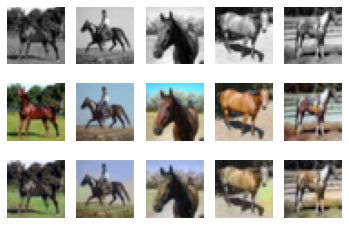

2 tensor(5.7815) tensor(0.7985)


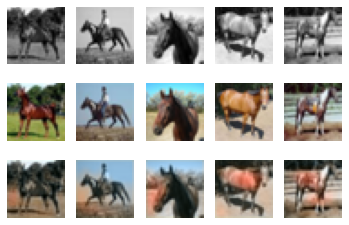

3 tensor(5.2160) tensor(1.2220)


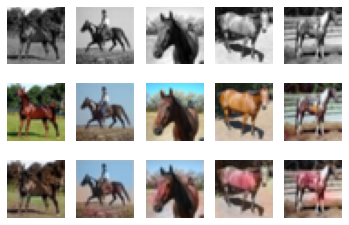

4 tensor(5.1077) tensor(1.1168)


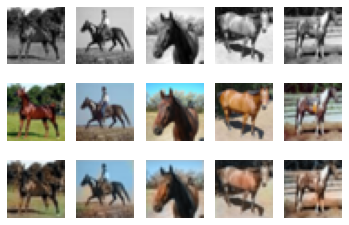

5 tensor(6.3715) tensor(1.0865)


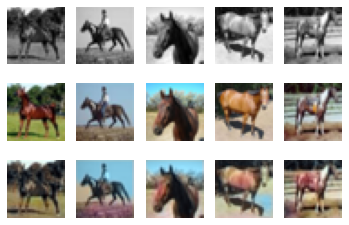

6 tensor(5.3369) tensor(0.7953)


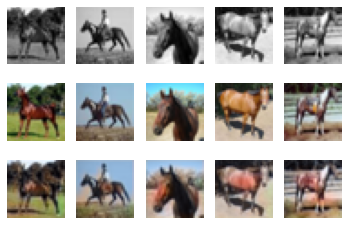

7 tensor(6.0068) tensor(0.7799)


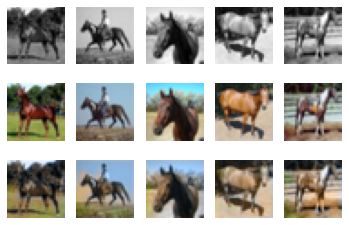

8 tensor(5.6831) tensor(0.8389)


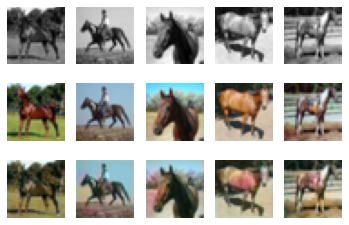

9 tensor(5.8600) tensor(0.8507)


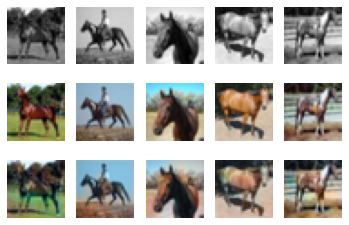

10 tensor(5.8546) tensor(1.2226)


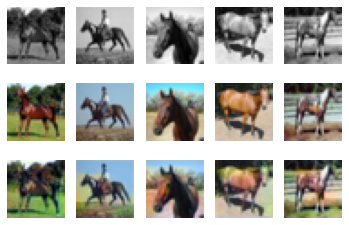

11 tensor(6.1266) tensor(0.6296)


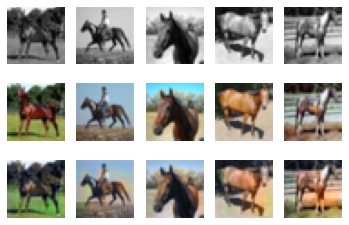

12 tensor(5.7979) tensor(0.7126)


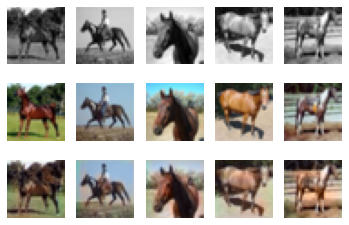

13 tensor(6.0912) tensor(0.9261)


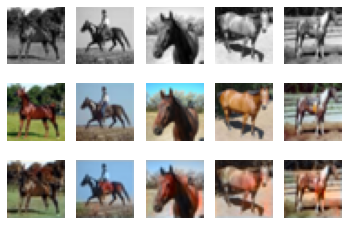

14 tensor(6.2509) tensor(0.5111)


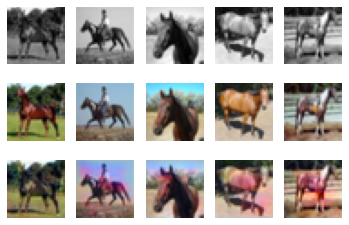

15 tensor(6.2407) tensor(0.8117)


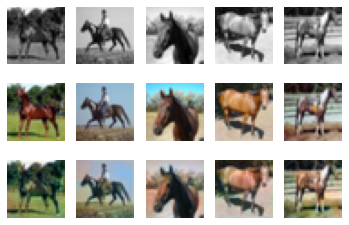

16 tensor(6.6038) tensor(0.6236)


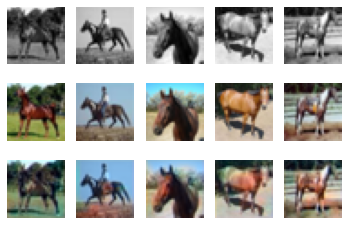

17 tensor(5.4793) tensor(1.2032)


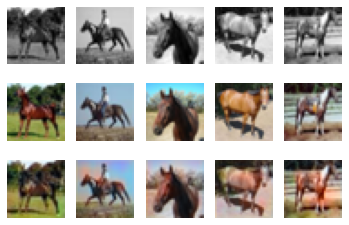

18 tensor(5.6627) tensor(0.8397)


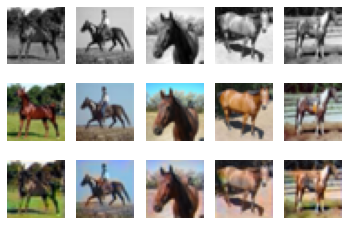

19 tensor(6.3990) tensor(0.5164)


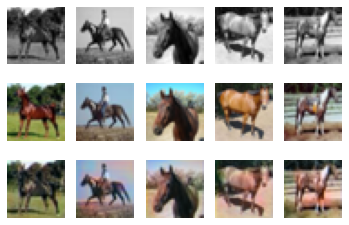

In [71]:
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'g_learn_rate':0.001,
    'd_learn_rate':0.0001, 
    "batch_size": 25,
    "epochs": 20,
    "seed": 0,
    "plot": True,
    "experiment_name": "colourization_cnn",
    "visualize": True,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args,cnn= pretrained_Unet)

*Here by using pretrained generator and combining L1loss with BCEloss, we were able to obtains results similar to previous best model with in 20 epochs instead of 150 epochs.*

## Testing New Data

In [52]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [53]:
from os import listdir
from matplotlib import image
import numpy as np

# load all images in a directory
loaded_images = list()
for filename in listdir('/content/drive/My Drive/horseimages/'):
	# load image
	img_data = image.imread('/content/drive/My Drive/horseimages/' + filename)
	loaded_images.append(img_data)
	print('> loaded %s %s' % (filename, img_data.shape))
Testing_images = np.array(loaded_images)

> loaded image4.jpg (32, 32, 3)
> loaded image5.jpg (32, 32, 3)
> loaded image3.jpg (32, 32, 3)
> loaded fin.jpg (32, 32, 3)
> loaded image7.jpg (32, 32, 3)
> loaded image0.jpg (32, 32, 3)
> loaded image6.jpg (32, 32, 3)
> loaded image9.jpeg (32, 32, 3)


In [75]:
def visual(img_grey, img_real, img_fake, num_images= 8):

  img_grey = img_grey
  img_real = img_real
  img_fake = img_fake.cpu().detach()
  plt.figure(figsize=(15,4))
  for i in range(num_images):
      ax = plt.subplot(3, 8, i + 1)
      ax.imshow(img_grey[i].reshape(32,32), cmap='gray')
      ax.axis("off")
      ax = plt.subplot(3, 8, i + 1 + 8)
      ax.imshow(np.swapaxes(img_real[i],0,2))
      ax.axis("off")
      ax = plt.subplot(3, 8, i + 1 + 16)
      ax.imshow(np.clip(np.swapaxes(img_fake[i].cpu().detach(),0,2),0,1))
      ax.axis("off")
  plt.show()

def process(xs, ys, max_pixel=256.0, downsize_input=False):
    xs = xs / max_pixel
    grey = np.mean(xs, axis=1, keepdims=True)

    return (xs, grey)

In [73]:
y = 7*np.ones((Testing_images.shape[0],1))
imgs = np.swapaxes(Testing_images,1,3)

x,y = process(imgs,y)
y = np.swapaxes(y,1,3)

x1,y1 = get_torch_vars(x.swapaxes(1,3),y.swapaxes(1,3))
out = cnn(y1.cuda())

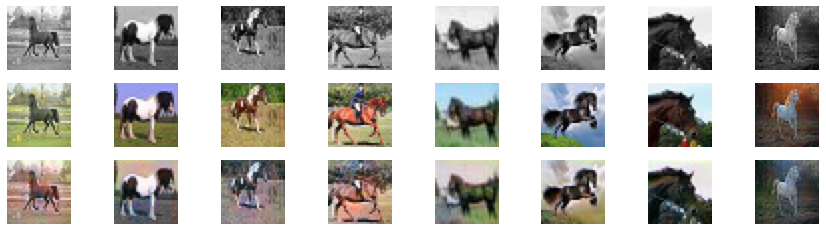

In [76]:
visual(y,x,out,num_images=x.shape[0])

*As it seems, my model did not work perfectly as it did on training data, as it is not picking green color properly, this may be because of overfitting. We can fine tune the model further, but given the time and gpu constraints on the colab, I was not able to try with all the combinations I wanted. But we can experiment by using patch discriminator and L1  loss for generator to further fine tune the colors at specific spots.*